## Preprocessing

In [ ]:
import cv2
import numpy as np
import os

# Function to apply gamma correction per channel
def adjust_gamma_channelwise(image, gamma=1.0):
    invGamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** invGamma) * 255 for i in np.arange(0, 256)]).astype("uint8")

    # Split the image into its component channels
    channels = cv2.split(image)

    # Apply the gamma correction on each channel
    channels_corrected = [cv2.LUT(ch, table) for ch in channels]

    # Merge the channels back together
    return cv2.merge(channels_corrected)

# Function to perform contrast stretching per channel
def contrast_stretching_channelwise(image):
    channels = cv2.split(image)
    channels_stretched = []

    for ch in channels:
        in_min = np.min(ch)
        in_max = np.max(ch)

        # Stretch the histogram to the full range
        stretched = cv2.normalize(ch, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
        channels_stretched.append(stretched)

    # Merge the channels back together
    return cv2.merge(channels_stretched)

# Paths to the input and output folders
input_folder = '/content/drive/MyDrive/Selected/Selected Positive'
output_folder = '/content/drive/MyDrive/Research Paper/Lyme Disease/preprocess'

# Create the output folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Process all images in the input folder
for filename in os.listdir(input_folder):
    if filename.lower().endswith(('.jpg')):
        file_path = os.path.join(input_folder, filename)
        image = cv2.imread(file_path)

        # Apply gamma correction with gamma=0.85
        gamma_corrected = adjust_gamma_channelwise(image, gamma=0.85)

        # Apply contrast stretching
        contrast_stretched = contrast_stretching_channelwise(gamma_corrected)

        # Save the processed image to the output folder
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, contrast_stretched)

print(f"Processed images have been saved to {output_folder}")


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/Selected/Selected Positive'

## AUgmentation

In [ ]:
from PIL import Image, ImageEnhance, ImageOps, ImageFilter
import numpy as np
import os

def add_noise(image):
    np_image = np.array(image)
    noise = np.random.normal(0, 25, np_image.shape)
    np_image = np.clip(np_image + noise, 0, 255).astype(np.uint8)
    return Image.fromarray(np_image)

def get_jpeg_filename(original_filename, prefix):
    return f"{prefix}_{original_filename.rsplit('.', 1)[0]}.jpg"

def augment_and_save_image(input_image, output_path, image_filename, rotation_angles, flip_horizontal, flip_vertical, brightness_factors, noise_addition, saturation_factors, contrast_factors, blur_factors, shear_factors):
    images_saved = 0
    base_filename = image_filename.rsplit('.', 1)[0]

    # Convert to JPEG and save the original image
    original_jpeg = input_image.convert('RGB')
    original_jpeg.save(os.path.join(output_path, f'{base_filename}.jpg'), 'JPEG')
    images_saved += 1

    # Apply augmentations
    for angle in rotation_angles:
        rotated_image = input_image.rotate(angle, expand=True).convert('RGB')
        rotated_image.save(os.path.join(output_path, get_jpeg_filename(image_filename, f'rotated_{angle}')), 'JPEG')
        images_saved += 1

    if flip_horizontal:
        h_flipped_image = ImageOps.mirror(input_image).convert('RGB')
        h_flipped_image.save(os.path.join(output_path, get_jpeg_filename(image_filename, 'hflip')), 'JPEG')
        images_saved += 1

    if flip_vertical:
        v_flipped_image = ImageOps.flip(input_image).convert('RGB')
        v_flipped_image.save(os.path.join(output_path, get_jpeg_filename(image_filename, 'vflip')), 'JPEG')
        images_saved += 1

    for factor in brightness_factors:
        enhancer = ImageEnhance.Brightness(input_image)
        brightness_image = enhancer.enhance(factor).convert('RGB')
        brightness_image.save(os.path.join(output_path, get_jpeg_filename(image_filename, f'brightness_{factor}')), 'JPEG')
        images_saved += 1

    if noise_addition:
        noisy_image = add_noise(input_image).convert('RGB')
        noisy_image.save(os.path.join(output_path, get_jpeg_filename(image_filename, 'noise')), 'JPEG')
        images_saved += 1

    for saturation_factor in saturation_factors:
        enhancer = ImageEnhance.Color(input_image)
        saturated_image = enhancer.enhance(saturation_factor).convert('RGB')
        saturated_image.save(os.path.join(output_path, get_jpeg_filename(image_filename, f'saturation_{saturation_factor}')), 'JPEG')
        images_saved += 1

    for contrast_factor in contrast_factors:
        enhancer = ImageEnhance.Contrast(input_image)
        contrasted_image = enhancer.enhance(contrast_factor).convert('RGB')
        contrasted_image.save(os.path.join(output_path, get_jpeg_filename(image_filename, f'contrast_{contrast_factor}')), 'JPEG')
        images_saved += 1

    for blur_factor in blur_factors:
        blurred_image = input_image.filter(ImageFilter.GaussianBlur(blur_factor)).convert('RGB')
        blurred_image.save(os.path.join(output_path, get_jpeg_filename(image_filename, f'blur_{blur_factor}')), 'JPEG')
        images_saved += 1

    for shear_factor in shear_factors:
        shear_matrix = [1, shear_factor, 0, 0, 1, 0]
        sheared_image = input_image.transform(input_image.size, Image.AFFINE, shear_matrix).convert('RGB')
        sheared_image.save(os.path.join(output_path, get_jpeg_filename(image_filename, f'shear_{shear_factor}')), 'JPEG')
        images_saved += 1

    return images_saved

def augment_images_in_folder(input_path, output_path, rotation_angles, flip_horizontal, flip_vertical, brightness_factors, noise_addition, saturation_factors, contrast_factors, blur_factors, shear_factors):
    total_images_saved = 0
    os.makedirs(output_path, exist_ok=True)

    for image_filename in os.listdir(input_path):
        if image_filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
            try:
                input_image_path = os.path.join(input_path, image_filename)
                input_image = Image.open(input_image_path)
                images_saved = augment_and_save_image(input_image, output_path, image_filename, rotation_angles, flip_horizontal, flip_vertical, brightness_factors, noise_addition, saturation_factors, contrast_factors, blur_factors, shear_factors)
                total_images_saved += images_saved
                if total_images_saved >= 4000:
                    break
            except FileNotFoundError:
                print(f"File not found: {image_filename}")
            except Exception as e:
                print(f"An error occurred with {image_filename}: {e}")



# Specify the input and output directory paths
input_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/preprocess'
output_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive'

# Call the function to augment all images in the input directory
augment_images_in_folder(
    input_path=input_path,
    output_path=output_path,
    rotation_angles=[30, 45, 90, 180, 270, 360],
    flip_horizontal=True,
    flip_vertical=True,
    brightness_factors=[0.5, 0.7, 1.3],
    noise_addition=True,
    saturation_factors=[0.5, 1.5],
    contrast_factors=[0.5, 1.5],
    blur_factors=[1, 2, 3],
    shear_factors=[0.2, 0.5]
)


In [ ]:
import shutil

# Specify the folder path to be deleted
folder_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive'

try:
    # Use shutil.rmtree to remove the folder and its contents recursively
    shutil.rmtree(folder_path)
    print(f"Deleted folder and its contents: {folder_path}")
except Exception as e:
    print(f"Error deleting folder: {e}")


In [ ]:
import os

# Specify the folder path
folder_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/negative'

# Initialize a set to store unique file extensions
extensions = set()

# List all files in the folder
for file_name in os.listdir(folder_path):
    # Split the file name into its base name and extension
    base_name, file_extension = os.path.splitext(file_name)
    # Add the extension (without the dot) to the set
    extensions.add(file_extension.lower())

# Print the unique image file extensions
print("Image file extensions in the folder:")
for ext in extensions:
    print(ext)


## **Import all Library**

In [ ]:
import numpy as np
import pandas as pd
from pathlib import Path
import os.path
import matplotlib.pyplot as plt
from IPython.display import Image, display, Markdown
import matplotlib.cm as cm
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import tensorflow as tf
import tensorflow as tf
from tensorflow import keras

from tensorflow.keras import datasets, layers, models

from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split

from keras.models import Sequential,load_model,Model
from keras.layers import Conv2D,MaxPool2D,AveragePooling2D,Dense,Flatten,ZeroPadding2D,BatchNormalization,Activation,Add,Input,Dropout,GlobalAveragePooling2D
from keras.optimizers import SGD
from keras.initializers import glorot_uniform
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from time import perf_counter
import seaborn as sns
import glob
import matplotlib.cm as cm
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

from sklearn.metrics import classification_report
from sklearn import metrics

import seaborn as sns
def printmd(string):
    # Print with Markdowns
    display(Markdown(string))

## Adding File Path

In [ ]:
image_dir = Path('/content/drive/MyDrive/Lyme Disease/Final_data')
filepaths = list(image_dir.glob(r'**/*.jpg'))
labels = list(map(lambda x: os.path.split(os.path.split(x)[0])[1], filepaths))

In [ ]:
# Count the number of files in the directory
total_files = sum(1 for _ in image_dir.glob('**/*.jpg'))

total_files

8120

In [ ]:
filepaths = pd.Series(filepaths, name='Filepath').astype(str)
labels = pd.Series(labels, name='Label')

# Concatenate filepaths and labels
image_df = pd.concat([filepaths, labels], axis=1)

# Shuffle the DataFrame and reset index
image_df = image_df.sample(frac=1).reset_index(drop = True)

# Show the result
image_df.head(3)

,Filepath,Label
0,/content/drive/MyDrive/Lyme Disease/Final_data...,negative
1,/content/drive/MyDrive/Lyme Disease/Final_data...,positive
2,/content/drive/MyDrive/Lyme Disease/Final_data...,negative


In [ ]:
# Display some pictures of the dataset with their labels
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(10, 7),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    ax.imshow(plt.imread(image_df.Filepath[i]))
    ax.set_title(image_df.Label[i])
plt.tight_layout()
plt.show()

In [ ]:
vc = image_df['Label'].value_counts()
print(vc)

<ipython-input-16-492fddd160da>:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=vc.index, y=vc, palette=custom_palette)
<ipython-input-16-492fddd160da>:22: UserWarning: The palette list has more values (4) than needed (2), which may not be intended.
  sns.barplot(x=vc.index, y=vc, palette=custom_palette)


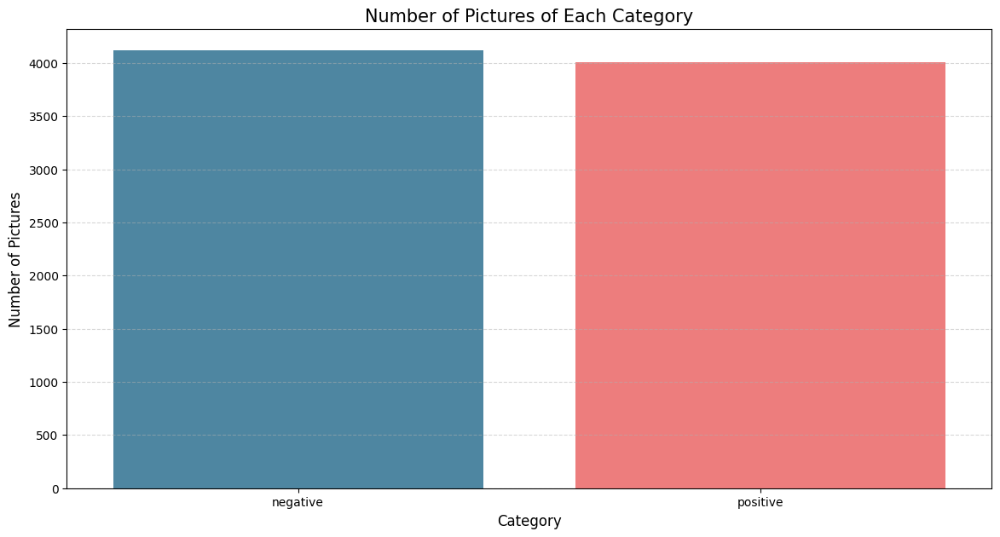

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Set the grid style
plt.rcParams['axes.grid'] = True
plt.rcParams['grid.linestyle'] = '--'
plt.rcParams['grid.alpha'] = 0.5

# Assume 'image_df' has a column 'Label' with categories 'Negative' and 'Positive'
# Calculate value counts for each label
vc = image_df['Label'].value_counts()  # Ensure image_df is defined

# Define your custom palette
custom_palette = ['#408baf', '#ff6b6b', '#36454f', '#ffd700']

# Set the figure size
plt.figure(figsize=(14, 7))

# Create a barplot with the custom palette
sns.barplot(x=vc.index, y=vc, palette=custom_palette)

# Set the title and labels
plt.title('Number of Pictures of Each Category', fontsize=15)
plt.xlabel('Category', fontsize=12)
plt.ylabel('Number of Pictures', fontsize=12)

# Define the directory to save the figure
output_directory = '/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput'  # Replace with your actual directory path
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Save the figure
plt.savefig(os.path.join(output_directory, 'image_category_plot.png'), bbox_inches='tight')

# Show the plot
plt.show()


## Data Split

In [ ]:
def create_gen():
    # Load the Images with a generator and Data Augmentation
    train_generator = tf.keras.preprocessing.image.ImageDataGenerator(
        preprocessing_function=tf.keras.applications.mobilenet_v2.preprocess_input,
        validation_split=0.1
    )

    test_generator = tf.keras.preprocessing.image.ImageDataGenerator(
        preprocessing_function=tf.keras.applications.mobilenet_v2.preprocess_input
    )

    train_images = train_generator.flow_from_dataframe(
        dataframe=train_df,
        x_col='Filepath',
        y_col='Label',
        target_size=(224, 224),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        shuffle=True,
    )

    val_images = train_generator.flow_from_dataframe(
        dataframe=train_df,
        x_col='Filepath',
        y_col='Label',
        target_size=(224, 224),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        shuffle=True,
    )

    test_images = test_generator.flow_from_dataframe(
        dataframe=test_df,
        x_col='Filepath',
        y_col='Label',
        target_size=(224, 224),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        shuffle=False
    )

    return train_generator,test_generator,train_images,val_images,test_images

In [ ]:
# Separate in train and test data
train_df, test_df = train_test_split(image_df, train_size=0.8, shuffle=True, random_state=1)

In [ ]:
# Create the generators
train_generator,test_generator,train_images,val_images,test_images=create_gen()

Found 6496 validated image filenames belonging to 2 classes.
Found 6496 validated image filenames belonging to 2 classes.
Found 1624 validated image filenames belonging to 2 classes.


In [ ]:
# Count in training data before split
train_counts = train_df['Label'].value_counts()

# Since we don't directly split the validation data,
# we infer its counts based on the validation_split and training data counts

# Count in test data
test_counts = test_df['Label'].value_counts()

print("Training dataset (before validation split) distribution:\n", train_counts)
print("\nTest dataset distribution:\n", test_counts)

# Note: This does not directly show the validation counts because they're a subset of train_df,
# but you can calculate it based on the `validation_split` percentage.


In [ ]:
# Assuming train_df has already been split and train_counts calculated as shown previously
validation_split_ratio = 0.1  # 10% of the data is for validation

# Calculate the expected number of samples for each class in the validation set
validation_counts = train_counts * validation_split_ratio

# Since validation_counts will be a Series with the count of each class,
# rounding might be necessary because actual counts of samples can't be fractional.
validation_counts_rounded = validation_counts.round().astype(int)

print("Expected validation dataset distribution (rounded):\n", validation_counts_rounded)


In [ ]:
# Adjust the training dataset counts to exclude the validation set
adjusted_train_counts = train_counts - validation_counts_rounded

print("Adjusted training dataset distribution (after validation split):\n", adjusted_train_counts)

## **Transfer Learning Model**

In [ ]:
# def get_model(model):
# # Load the pretained model
#     kwargs =    {'input_shape':(224, 224, 3),
#                 'include_top':False,
#                 'weights':'imagenet',
#                 'pooling':'avg'}

#     pretrained_model = model(**kwargs)
#     pretrained_model.trainable = False

#     inputs = pretrained_model.input

#     x = tf.keras.layers.Dense(256, activation='relu')(pretrained_model.output)
#     x = tf.keras.layers.Dense(256, activation='relu')(x)

#     outputs = tf.keras.layers.Dense(2, activation='softmax')(x)

#     model = tf.keras.Model(inputs=inputs, outputs=outputs)

#     model.compile(
#         optimizer='adam',
#         loss='categorical_crossentropy',
#         metrics=['accuracy']
#     )
#     return model
def get_model(model):
    # Load the pretrained model with specified kwargs
    kwargs = {
        'input_shape': (224, 224, 3),
        'include_top': False,
        'weights': 'imagenet',
        'pooling': 'avg'
    }

    pretrained_model = model(**kwargs)
    pretrained_model.trainable = False  # Freeze the pretrained model

    inputs = pretrained_model.input

    # Use a simpler architecture with potentially less capacity to learn complex patterns
    x = tf.keras.layers.Dense(128, activation='linear')(pretrained_model.output)  # Reduced number of neurons and linear activation

    outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    model.compile(
        optimizer='adam',  # Potentially inappropriate learning rate
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    return model

##Model Fit

In [ ]:
# Dictionary with the models
models = {
    "VGG19": {"model": tf.keras.applications.VGG19, "perf": 0},
    "ResNet50V2": {"model": tf.keras.applications.ResNet50V2, "perf": 0},
    "DenseNet201": {"model": tf.keras.applications.DenseNet201, "perf": 0},
}
# Custom color palette
custom_palette = ['#8CB368', '#B4D8DE', '#36454f', '#211d38']
# Create the generators
# train_generator,test_generator,train_images,val_images,test_images=create_gen()
print('\n')
output_dir = "/content/drive/MyDrive/Research Paper/Lyme Disease/AfterTuning"
os.makedirs(output_dir, exist_ok=True)
# Fit the models
for name, model in models.items():
    # Get the model
    m = get_model(model['model'])
    models[name]['model'] = m

    print(f"{name} Model : ")

    start = perf_counter()

    # Fit the model
    # Assuming train_images and val_images are generators or datasets ready for training.
    history = m.fit(train_images, validation_data=val_images, epochs=20, verbose=1)

    # Save the duration, the train_accuracy, and the val_accuracy
    duration = perf_counter() - start
    duration = round(duration, 2)
    models[name]['perf'] = duration
    print(f"{name} trained in {duration} sec")

    val_acc = history.history['val_accuracy']
    models[name]['val_acc'] = [round(v, 4) for v in val_acc]

    train_acc = history.history['accuracy']
    models[name]['train_accuracy'] = [round(v, 4) for v in train_acc]

    # Evaluate the model
    results = m.evaluate(test_images, verbose=0)
    res = results[1]
    models[name]['test_accuracy'] = [round(res, 4)]

    # Plotting training accuracy and loss
    plt.figure()
    pd.DataFrame(history.history)[['accuracy', 'val_accuracy']].plot()
    plt.title(f"{name} Training Accuracy")
    plt.xticks(range(0, 21, 2))  # Setting x-axis ticks
    accuracy_plot = os.path.join(output_dir, f"{name}_accuracy_plot.png")
    plt.savefig(accuracy_plot)
    plt.show()

    plt.figure()
    pd.DataFrame(history.history)[['loss', 'val_loss']].plot()
    plt.title(f"{name} Training Loss")
    plt.xticks(range(0, 21, 2))  # Setting x-axis ticks
    loss_plot = os.path.join(output_dir, f"{name}_loss_plot.png")
    plt.savefig(loss_plot)
    plt.show()

    print(f"\nAccuracy on the test set for {name}: {results[1] * 100:.2f}%")


    from sklearn.metrics import confusion_matrix
    import seaborn as sns

    # Evaluation and Confusion Matrix
    pred = m.predict(test_images)
    pred = np.argmax(pred, axis=1)

    # Mapping the label
    labels = (train_images.class_indices)
    labels = dict((v, k) for k, v in labels.items())
    pred = [labels[k] for k in pred]
    y_test = list(test_df.Label)  # Assuming test_df is defined

    print('Accuracy:', np.round(metrics.accuracy_score(y_test, pred),5))
    print('Precision:', np.round(metrics.precision_score(y_test, pred, average='weighted'),5))
    print('Recall:', np.round(metrics.recall_score(y_test,pred, average='weighted'),5))
    print('F1 Score:', np.round(metrics.f1_score(y_test, pred, average='weighted'),5))
    print(classification_report(y_test, pred))


    from sklearn.metrics import mean_absolute_error
    from sklearn.metrics import mean_squared_error
    import math
    from numpy import mean


    print(f"{name:2} Confusion Matrix: \n\n")
    cf_matrix = confusion_matrix(y_test, pred, normalize='true')
    plt.figure(figsize=(10, 6))
    sns.heatmap(cf_matrix, annot=True, cmap=sns.color_palette(custom_palette, as_cmap=True),
                xticklabels=sorted(set(y_test)), yticklabels=sorted(set(y_test)))
    plt.title(f'{name} Normalized Confusion Matrix')
    confusion_matrix_plot = os.path.join(output_dir, f"{name}_confusion_matrix.png")
    plt.savefig(confusion_matrix_plot)
    plt.show()
    confusion_matrix=cf_matrix

    FP = confusion_matrix.sum(axis=0) - np.diag(confusion_matrix)
    FN = confusion_matrix.sum(axis=1) - np.diag(confusion_matrix)
    TP = np.diag(confusion_matrix)
    TN = len(y_test) - (FP + FN + TP)

    # Sensitivity, hit rate, recall, or true positive rate
    TPR = TP/(TP+FN)
    # Specificity or true negative rate
    TNR = TN/(TN+FP)
    # Precision or positive predictive value
    PPV = TP/(TP+FP)
    # Negative predictive value
    NPV = TN/(TN+FN)
    # Fall out or false positive rate
    FPR = FP/(FP+TN)
    # False negative rate
    FNR = FN/(TP+FN)
    # False discovery rate
    FDR = FP/(TP+FP)
    # Printing performance metrics
    print("Performance for", name)
    print("Recall (Sensitivity):", np.mean(TPR)*100)
    print("Specificity:", np.mean(TNR)*100)
    print("Precision:", np.mean(PPV)*100)
    print("False Positive Rate:", np.mean(FPR)*100)
    print("False Negative Rate:", np.mean(FNR)*100)
    print("Negative Predictive Value:", np.mean(NPV)*100)
    print("False Discovery Rate:", np.mean(FDR)*100)
    print("\n")


## DenseNet201

In [ ]:
# Dictionary with the models
models = {
    # "VGG19": {"model": tf.keras.applications.VGG19, "perf": 0},
    # "ResNet50V2": {"model": tf.keras.applications.ResNet50V2, "perf": 0},
    "DenseNet201": {"model": tf.keras.applications.DenseNet201, "perf": 0},
}
# Custom color palette
custom_palette = ['#8CB368', '#B4D8DE', '#36454f', '#211d38']
# Create the generators
# train_generator,test_generator,train_images,val_images,test_images=create_gen()
print('\n')
output_dir = "/content/drive/MyDrive/Research Paper/Lyme Disease/AfterTuning/DenseNet201"
os.makedirs(output_dir, exist_ok=True)
# Fit the models
for name, model in models.items():
    # Get the model
    m = get_model(model['model'])
    models[name]['model'] = m

    print(f"{name} Model : ")

    start = perf_counter()

    # Fit the model
    # Assuming train_images and val_images are generators or datasets ready for training.
    history = m.fit(train_images, validation_data=val_images, epochs=20, verbose=1)

    # Save the duration, the train_accuracy, and the val_accuracy
    duration = perf_counter() - start
    duration = round(duration, 2)
    models[name]['perf'] = duration
    print(f"{name} trained in {duration} sec")

    val_acc = history.history['val_accuracy']
    models[name]['val_acc'] = [round(v, 4) for v in val_acc]

    train_acc = history.history['accuracy']
    models[name]['train_accuracy'] = [round(v, 4) for v in train_acc]

    # Evaluate the model
    results = m.evaluate(test_images, verbose=0)
    res = results[1]
    models[name]['test_accuracy'] = [round(res, 4)]

    # Plotting training accuracy and loss
    plt.figure()
    pd.DataFrame(history.history)[['accuracy', 'val_accuracy']].plot()
    plt.title(f"{name} Training Accuracy")
    plt.xticks(range(0, 21, 2))  # Setting x-axis ticks
    accuracy_plot = os.path.join(output_dir, f"{name}_accuracy_plot.png")
    plt.savefig(accuracy_plot)
    plt.show()

    plt.figure()
    pd.DataFrame(history.history)[['loss', 'val_loss']].plot()
    plt.title(f"{name} Training Loss")
    plt.xticks(range(0, 21, 2))  # Setting x-axis ticks
    loss_plot = os.path.join(output_dir, f"{name}_loss_plot.png")
    plt.savefig(loss_plot)
    plt.show()

    print(f"\nAccuracy on the test set for {name}: {results[1] * 100:.2f}%")


    from sklearn.metrics import confusion_matrix
    import seaborn as sns

    # Evaluation and Confusion Matrix
    pred = m.predict(test_images)
    pred = np.argmax(pred, axis=1)

    # Mapping the label
    labels = (train_images.class_indices)
    labels = dict((v, k) for k, v in labels.items())
    pred = [labels[k] for k in pred]
    y_test = list(test_df.Label)  # Assuming test_df is defined

    print('Accuracy:', np.round(metrics.accuracy_score(y_test, pred),5))
    print('Precision:', np.round(metrics.precision_score(y_test, pred, average='weighted'),5))
    print('Recall:', np.round(metrics.recall_score(y_test,pred, average='weighted'),5))
    print('F1 Score:', np.round(metrics.f1_score(y_test, pred, average='weighted'),5))
    print(classification_report(y_test, pred))


    from sklearn.metrics import mean_absolute_error
    from sklearn.metrics import mean_squared_error
    import math
    from numpy import mean


    print(f"{name:2} Confusion Matrix: \n\n")
    cf_matrix = confusion_matrix(y_test, pred, normalize='true')
    plt.figure(figsize=(10, 6))
    sns.heatmap(cf_matrix, annot=True, cmap=sns.color_palette(custom_palette, as_cmap=True),
                xticklabels=sorted(set(y_test)), yticklabels=sorted(set(y_test)))
    plt.title(f'{name} Normalized Confusion Matrix')
    confusion_matrix_plot = os.path.join(output_dir, f"{name}_confusion_matrix.png")
    plt.savefig(confusion_matrix_plot)
    plt.show()
    confusion_matrix=cf_matrix

    FP = confusion_matrix.sum(axis=0) - np.diag(confusion_matrix)
    FN = confusion_matrix.sum(axis=1) - np.diag(confusion_matrix)
    TP = np.diag(confusion_matrix)
    TN = len(y_test) - (FP + FN + TP)

    # Sensitivity, hit rate, recall, or true positive rate
    TPR = TP/(TP+FN)
    # Specificity or true negative rate
    TNR = TN/(TN+FP)
    # Precision or positive predictive value
    PPV = TP/(TP+FP)
    # Negative predictive value
    NPV = TN/(TN+FN)
    # Fall out or false positive rate
    FPR = FP/(FP+TN)
    # False negative rate
    FNR = FN/(TP+FN)
    # False discovery rate
    FDR = FP/(TP+FP)
    # Printing performance metrics
    print("Performance for", name)
    print("Recall (Sensitivity):", np.mean(TPR)*100)
    print("Specificity:", np.mean(TNR)*100)
    print("Precision:", np.mean(PPV)*100)
    print("False Positive Rate:", np.mean(FPR)*100)
    print("False Negative Rate:", np.mean(FNR)*100)
    print("Negative Predictive Value:", np.mean(NPV)*100)
    print("False Discovery Rate:", np.mean(FDR)*100)
    print("\n")


## Save Model


In [ ]:
for name, model_data in models.items():
    model = model_data['model']
    model.save(f'/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/ModelD201/{name}')

## Roc Dense

In [ ]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
import numpy as np
import matplotlib.pyplot as plt
import os

# Custom color palette
custom_palette = ['#8CB368', '#B4D8DE', '#36454f', '#211d38']

# Output directory
output_dir = "/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/D2"
os.makedirs(output_dir, exist_ok=True)

# Fit the models
for name, model_info in models.items():
    # Get the model
    m = model_info['model']

    print(f"\n{ '=' * 20 } { name } {'=' * 20 }")

    # Check the unique classes in y_test
    unique_classes = np.unique(y_test)  # Assuming y_test is defined
    print("Unique classes in y_test:", unique_classes)

    # Ensure that there are 2 unique classes
    if len(unique_classes) != 2:
        raise ValueError("Expected 2 unique classes in y_test, got {}".format(len(unique_classes)))

    # Convert labels to binary matrix
    y_test_bin = label_binarize(y_test, classes=unique_classes)

    # Handling a special case for binary classification
    if y_test_bin.shape[1] == 1:
        y_test_bin = np.hstack((1 - y_test_bin, y_test_bin))

    # Predict probabilities for each class
    y_score = m.predict(test_images)  # Ensure test_images is defined

    # Ensure that y_score has two columns
    if y_score.shape[1] != 2:
        raise ValueError("y_score should have 2 columns for 2 classes, found {}".format(y_score.shape[1]))

    # Compute ROC curve and AUC for each class
    fpr, tpr, roc_auc = {}, {}, {}
    for i in range(2):
        fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Compute micro-average ROC curve and AUC
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_score.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    # Plot ROC curves
    plt.figure(figsize=(10, 6))
    colors = custom_palette[:2] + ['black']
    for i, color in zip(range(2), colors):
        plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

    plt.plot(fpr["micro"], tpr["micro"], color=custom_palette[3],
             label=f'Micro-average (AUC = {roc_auc["micro"]:.2f})', linestyle=':', linewidth=4)

    plt.plot([0, 1], [0, 1], 'k--', linewidth=2)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'{name} ROC Curve for each Class')
    plt.legend(loc='lower right')

    # Saving the plot
    roc_plot = os.path.join(output_dir, f"{name}_ROC_Curve.png")
    plt.savefig(roc_plot)
    plt.show()

    print(f"ROC curve saved for {name}")

##  ROC curve

In [ ]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
import numpy as np
import matplotlib.pyplot as plt
import os

# Custom color palette
custom_palette = ['#8CB368', '#B4D8DE', '#36454f', '#211d38']

# Output directory
output_dir = "/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput"
os.makedirs(output_dir, exist_ok=True)

# Fit the models
for name, model_info in models.items():
    # Get the model
    m = model_info['model']

    print(f"\n{ '=' * 20 } { name } {'=' * 20 }")

    # Check the unique classes in y_test
    unique_classes = np.unique(y_test)  # Assuming y_test is defined
    print("Unique classes in y_test:", unique_classes)

    # Ensure that there are 2 unique classes
    if len(unique_classes) != 2:
        raise ValueError("Expected 2 unique classes in y_test, got {}".format(len(unique_classes)))

    # Convert labels to binary matrix
    y_test_bin = label_binarize(y_test, classes=unique_classes)

    # Handling a special case for binary classification
    if y_test_bin.shape[1] == 1:
        y_test_bin = np.hstack((1 - y_test_bin, y_test_bin))

    # Predict probabilities for each class
    y_score = m.predict(test_images)  # Ensure test_images is defined

    # Ensure that y_score has two columns
    if y_score.shape[1] != 2:
        raise ValueError("y_score should have 2 columns for 2 classes, found {}".format(y_score.shape[1]))

    # Compute ROC curve and AUC for each class
    fpr, tpr, roc_auc = {}, {}, {}
    for i in range(2):
        fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Compute micro-average ROC curve and AUC
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_score.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    # Plot ROC curves
    plt.figure(figsize=(10, 6))
    colors = custom_palette[:2] + ['black']
    for i, color in zip(range(2), colors):
        plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

    plt.plot(fpr["micro"], tpr["micro"], color=custom_palette[3],
             label=f'Micro-average (AUC = {roc_auc["micro"]:.2f})', linestyle=':', linewidth=4)

    plt.plot([0, 1], [0, 1], 'k--', linewidth=2)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'{name} ROC Curve for each Class')
    plt.legend(loc='lower right')

    # Saving the plot
    roc_plot = os.path.join(output_dir, f"{name}_ROC_Curve.png")
    plt.savefig(roc_plot)
    plt.show()

    print(f"ROC curve saved for {name}")

## Miss Dense

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os

# Custom color palette
custom_palette = ['#8CB368', '#B4D8DE', '#36454f', '#211d38']

# Output directory
output_dir = "/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/D2"
os.makedirs(output_dir, exist_ok=True)

# Fit the models
for name, model_info in models.items():
    # Get the model
    m = model_info['model']

    print(f"\n{ '=' * 20 } { name } {'=' * 20 }")

    # Reset the state of the test_images generator
    test_images.reset()

    # Get predictions on the test set
    y_pred = m.predict(test_images)
    y_pred_classes = np.argmax(y_pred, axis=1)

    # Get true labels
    y_true = test_images.classes

    # Calculate misclassification error
    misclassification_error = 1 - accuracy_score(y_true, y_pred_classes)

    print(f'Misclassification Error: {misclassification_error:.4f}')

    # Display classification report
    print('\nClassification Report:\n', classification_report(y_true, y_pred_classes))

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred_classes)
    plt.figure(figsize=(8, 6), dpi=300)
    sns.heatmap(cm, annot=True, fmt='g', cmap=sns.color_palette(custom_palette, as_cmap=True),
                xticklabels=sorted(set(y_true)), yticklabels=sorted(set(y_true)))
    plt.title(f'{name} Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Saving the plot
    confusion_matrix_plot = os.path.join(output_dir, f"{name}_Confusion_Matrix.png")
    plt.savefig(confusion_matrix_plot, bbox_inches='tight')
    plt.show()

    print(f"Confusion matrix saved for {name}")

## Misclassification Error of the Transfer Leraning Models

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os

# Custom color palette
custom_palette = ['#8CB368', '#B4D8DE', '#36454f', '#211d38']

# Output directory
output_dir = "/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput"
os.makedirs(output_dir, exist_ok=True)

# Fit the models
for name, model_info in models.items():
    # Get the model
    m = model_info['model']

    print(f"\n{ '=' * 20 } { name } {'=' * 20 }")

    # Reset the state of the test_images generator
    test_images.reset()

    # Get predictions on the test set
    y_pred = m.predict(test_images)
    y_pred_classes = np.argmax(y_pred, axis=1)

    # Get true labels
    y_true = test_images.classes

    # Calculate misclassification error
    misclassification_error = 1 - accuracy_score(y_true, y_pred_classes)

    print(f'Misclassification Error: {misclassification_error:.4f}')

    # Display classification report
    print('\nClassification Report:\n', classification_report(y_true, y_pred_classes))

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred_classes)
    plt.figure(figsize=(8, 6), dpi=300)
    sns.heatmap(cm, annot=True, fmt='g', cmap=sns.color_palette(custom_palette, as_cmap=True),
                xticklabels=sorted(set(y_true)), yticklabels=sorted(set(y_true)))
    plt.title(f'{name} Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Saving the plot
    confusion_matrix_plot = os.path.join(output_dir, f"{name}_Confusion_Matrix.png")
    plt.savefig(confusion_matrix_plot, bbox_inches='tight')
    plt.show()

    print(f"Confusion matrix saved for {name}")

## Transfer Leraning model class_probabilities Single Image


In [ ]:
import os

# Assuming you have a dictionary named models
models = {
    'model1': '/content/drive/MyDrive/Research Paper/Final_Model/DenseNet201',
    'model2': '/content/drive/MyDrive/Research Paper/Final_Model/ResNet50V2',
    'model3': '/content/drive/MyDrive/Research Paper/Final_Model/VGG19'
}

loaded_models = {}

for name, path in models.items():
    loaded_model = tf.keras.models.load_model(path)
    loaded_models[name] = loaded_model



In [ ]:
# Define a function for image classification
def classify_image(model, image_path, class_names):
    img = image.load_img(image_path, target_size=(224, 224))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img /= 255.0  # Rescale the image to match the training data preprocessing

    # Make predictions
    predictions = model.predict(img)

    # Get the class label with the highest probability
    predicted_class = np.argmax(predictions)

    # Get the class name
    class_name = class_names[predicted_class]

    return class_name, predictions[0]


In [ ]:
from tensorflow.keras.preprocessing import image
# Load the saved models
model_DenseNet201 = tf.keras.models.load_model("/content/drive/MyDrive/Research Paper/Final_Model/DenseNet201")
model_ResNet50V2 = tf.keras.models.load_model("/content/drive/MyDrive/Research Paper/Final_Model/ResNet50V2")
model_VGG19 = tf.keras.models.load_model("/content/drive/MyDrive/Research Paper/Final_Model/VGG19")

image_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/Final Data/positive/contrast_EM rash153.jpg'

# Define your class names
class_names = ["negative", "positive"]

# Perform classification for DenseNet201
class_name_DenseNet201, probabilities_DenseNet201 = classify_image(model_DenseNet201, image_path, class_names)

# Perform classification for ResNet50V2
class_name_ResNet50V2, probabilities_ResNet50V2 = classify_image(model_ResNet50V2, image_path, class_names)

# Perform classification for VGG19
class_name_VGG19, probabilities_VGG19 = classify_image(model_VGG19, image_path, class_names)

In [ ]:
# Print the results for DenseNet201
print("DenseNet201 Prediction:")
print(f"Predicted Class: {class_name_DenseNet201}")
print("Class Probabilities:")
for i, prob in enumerate(probabilities_DenseNet201):
    print(f"{class_names[i]}: {prob:.4f}")
print("\n")

# Print the results for ResNet50V2
print("ResNet50V2 Prediction:")
print(f"Predicted Class: {class_name_ResNet50V2}")
print("Class Probabilities:")
for i, prob in enumerate(probabilities_ResNet50V2):
    print(f"{class_names[i]}: {prob:.4f}")
print("\n")

# Print the results for VGG19
print("VGG19 Prediction:")
print(f"Predicted Class: {class_name_VGG19}")
print("Class Probabilities:")
for i, prob in enumerate(probabilities_VGG19):
    print(f"{class_names[i]}: {prob:.4f}")
print("\n")

# Plot the image with predicted class names
plt.figure(figsize=(4, 4))
plt.imshow(image.load_img(image_path, target_size=(224, 224)))
plt.axis('off')
plt.title(f"DenseNet201: {class_name_DenseNet201}\nResNet50V2: {class_name_ResNet50V2}\nVGG19: {class_name_VGG19}")
plt.show()

In [ ]:
from tensorflow.keras.preprocessing import image
# Load the saved models
model_DenseNet201 = tf.keras.models.load_model("/content/drive/MyDrive/Research Paper/Final_Model/DenseNet201")
model_ResNet50V2 = tf.keras.models.load_model("/content/drive/MyDrive/Research Paper/Final_Model/ResNet50V2")
model_VGG19 = tf.keras.models.load_model("/content/drive/MyDrive/Research Paper/Final_Model/VGG19")

image_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/Final Data/negative/Bacterial cellulitis109.jpg'

# Define your class names
class_names = ["negative", "positive"]

# Perform classification for DenseNet201
class_name_DenseNet201, probabilities_DenseNet201 = classify_image(model_DenseNet201, image_path, class_names)

# Perform classification for ResNet50V2
class_name_ResNet50V2, probabilities_ResNet50V2 = classify_image(model_ResNet50V2, image_path, class_names)

# Perform classification for VGG19
class_name_VGG19, probabilities_VGG19 = classify_image(model_VGG19, image_path, class_names)

In [ ]:
# Print the results for DenseNet201
print("DenseNet201 Prediction:")
print(f"Predicted Class: {class_name_DenseNet201}")
print("Class Probabilities:")
for i, prob in enumerate(probabilities_DenseNet201):
    print(f"{class_names[i]}: {prob:.4f}")
print("\n")

# Print the results for ResNet50V2
print("ResNet50V2 Prediction:")
print(f"Predicted Class: {class_name_ResNet50V2}")
print("Class Probabilities:")
for i, prob in enumerate(probabilities_ResNet50V2):
    print(f"{class_names[i]}: {prob:.4f}")
print("\n")

# Print the results for VGG19
print("VGG19 Prediction:")
print(f"Predicted Class: {class_name_VGG19}")
print("Class Probabilities:")
for i, prob in enumerate(probabilities_VGG19):
    print(f"{class_names[i]}: {prob:.4f}")
print("\n")


# Plot the image with predicted class names
plt.figure(figsize=(4, 4))
plt.imshow(image.load_img(image_path, target_size=(224, 224)))
plt.axis('off')
plt.title(f"DenseNet201: {class_name_DenseNet201}\nResNet50V2: {class_name_ResNet50V2}\nVGG19: {class_name_VGG19}")
plt.show()

## Hybrid Model DensNet201 and VGG19

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, GlobalAveragePooling2D, Concatenate, BatchNormalization, Activation, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.applications import DenseNet201, VGG19
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2

# Define the input shape
input_shape = (224, 224, 3)

# Enable mixed precision
policy = tf.keras.mixed_precision.Policy('mixed_float16')
tf.keras.mixed_precision.set_global_policy(policy)

# Define the input layer
input_layer = Input(shape=input_shape, name='input_layer')

# Load pre-trained models
densenet_model = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
vgg19_model = VGG19(weights='imagenet', include_top=False, input_tensor=input_layer)

# Global average pooling layer for each model
densenet_gap = GlobalAveragePooling2D()(densenet_model.output)
vgg19_gap = GlobalAveragePooling2D()(vgg19_model.output)

# Concatenate the outputs from both models
concatenated_features = Concatenate()([densenet_gap, vgg19_gap])

# Adding Batch Normalization before the Dense layer
concatenated_features_bn = BatchNormalization()(concatenated_features)

# Additional dense layers for further processing with L2 regularization and Dropout
dense_layer1 = Dense(512, kernel_regularizer=l2(0.001))(concatenated_features_bn)  # Consider tuning the L2 regularization rate
dense_layer1_bn = BatchNormalization()(dense_layer1)
dense_layer1_act = Activation('relu')(dense_layer1_bn)
dense_layer1_dropout = Dropout(0.5)(dense_layer1_act)  # Consider tuning the Dropout rate

dense_layer2 = Dense(256, kernel_regularizer=l2(0.001))(dense_layer1_dropout)  # L2 regularization
dense_layer2_bn = BatchNormalization()(dense_layer2)
dense_layer2_act = Activation('relu')(dense_layer2_bn)
dense_layer2_dropout = Dropout(0.5)(dense_layer2_act)  # Dropout

# Output layer for binary classification
output_layer = Dense(2, activation='softmax', dtype='float32')(dense_layer2_dropout)  # Ensuring dtype='float32' for the output with mixed precision

# Create the hybrid model
hybrid_model = Model(inputs=input_layer, outputs=output_layer)

# Compile the model using the Adam optimizer with a tunable learning rate
optimizer = Adam(learning_rate=0.00001)  # Consider tuning the learning rate

hybrid_model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Display the model summary
# hybrid_model.summary()


74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


## Model Fit


In [ ]:
# Fit the model
history = hybrid_model.fit(train_images, validation_data=val_images, epochs=20, verbose=1)

Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


203/203 ━━━━━━━━━━━━━━━━━━━━ 3033s 12s/step - accuracy: 0.6181 - loss: 1.9216 - val_accuracy: 0.8816 - val_loss: 1.4901
Epoch 2/20
203/203 ━━━━━━━━━━━━━━━━━━━━ 197s 691ms/step - accuracy: 0.8464 - loss: 1.4978 - val_accuracy: 0.9443 - val_loss: 1.2967
Epoch 3/20
203/203 ━━━━━━━━━━━━━━━━━━━━ 128s 625ms/step - accuracy: 0.9192 - loss: 1.3351 - val_accuracy: 0.9712 - val_loss: 1.1967
Epoch 4/20
203/203 ━━━━━━━━━━━━━━━━━━━━ 141s 691ms/step - accuracy: 0.9374 - loss: 1.2461 - val_accuracy: 0.9754 - val_loss: 1.1459
Epoch 5/20
203/203 ━━━━━━━━━━━━━━━━━━━━ 141s 690ms/step - accuracy: 0.9569 - loss: 1.1773 - val_accuracy: 0.9906 - val_loss: 1.0866
Epoch 6/20
203/203 ━━━━━━━━━━━━━━━━━━━━ 143s 693ms/step - accuracy: 0.9706 - loss: 1.1280 - val_accuracy: 0.9952 - val_loss: 1.0470
Epoch 7/20
203/203 ━━━━━━━━━━━━━━━━━━━━ 130s 637ms/step - accuracy: 0.9820 - loss: 1.0769 - val_accuracy: 0.9952 - val_loss: 1.0169
Epoch 8/20
203/203 ━━━━━━━━━━━━━━━━━━━━ 130s 637ms/step - accuracy: 0.9839 - loss: 1.040

## Save Model

In [ ]:
# Specify the path and include the .h5 extension
hybrid_model.save('/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/Model/Skin-VisualNet.h5')

## Result Analysis

<Figure size 640x480 with 0 Axes>

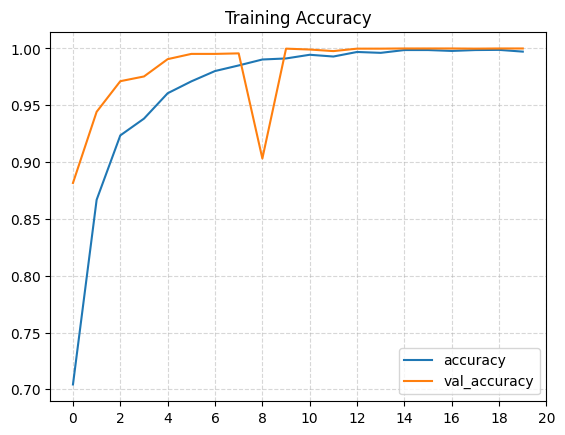

<Figure size 640x480 with 0 Axes>

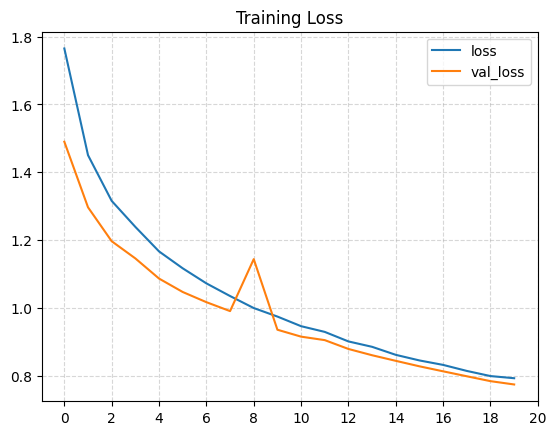



Accuracy on the test set: 98.34%
51/51 ━━━━━━━━━━━━━━━━━━━━ 46s 465ms/step
Accuracy: 0.98337
Precision: 0.98359
Recall: 0.98337
F1 Score: 0.98337
              precision    recall  f1-score   support

    negative       0.97      0.99      0.98       809
    positive       0.99      0.97      0.98       815

    accuracy                           0.98      1624
   macro avg       0.98      0.98      0.98      1624
weighted avg       0.98      0.98      0.98      1624

Confusion Matrix of Skin-VisualNet: 




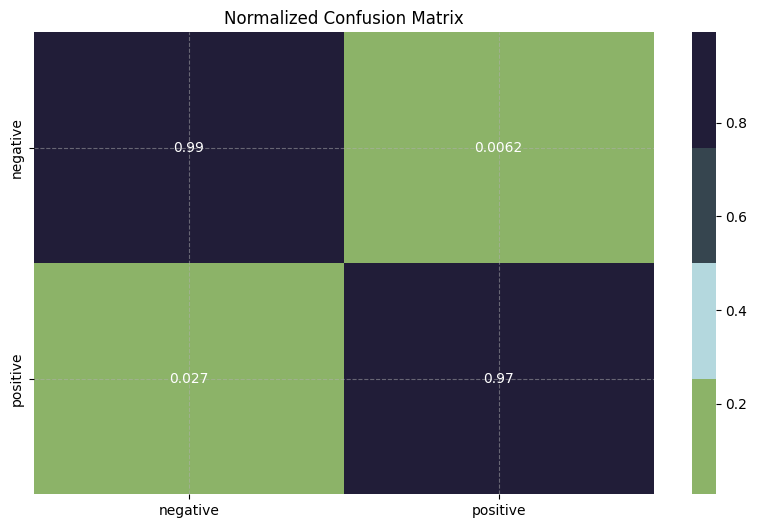

Performance: 

Recall: 98.34128326268134
Specificity: 99.99897799338429
Precision: 98.36223365774674
False Positive Rate: 0.001022006615723146
False Negative Rate: 1.6587167373186607
Negative Predictive Value: 99.99897800160689
False Discovery Rate: 1.6377663422532502


In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import load_model
from sklearn import metrics
from sklearn.metrics import classification_report, confusion_matrix
from statistics import mean

# Directory to save the figures
output_dir = '/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutputDEMO'  # Update this to your desired path
os.makedirs(output_dir, exist_ok=True)
print('\n')

# Assuming history, hybrid_model, test_images, and train_images are defined
# ...

val_acc = history.history['val_accuracy']
train_acc = history.history['accuracy']
results = hybrid_model.evaluate(test_images, verbose=0)
res = results[1]
test_acc = [round(res, 4)]

# Plotting training accuracy and loss
plt.figure()
pd.DataFrame(history.history)[['accuracy', 'val_accuracy']].plot()
plt.title("Training Accuracy")
plt.xticks(range(0, 21, 2))  # Set x-axis ticks to specific values
plt.savefig(os.path.join(output_dir, 'training_accuracy_plot.png'))  # Save the figure
plt.show()

plt.figure()
pd.DataFrame(history.history)[['loss', 'val_loss']].plot()
plt.title("Training Loss")
plt.xticks(range(0, 21, 2))  # Set x-axis ticks to specific values
plt.savefig(os.path.join(output_dir, 'training_loss_plot.png'))  # Save the figure
plt.show()

# Display accuracy on the test set
print("\n\nAccuracy on the test set: {:.2f}%".format(results[1] * 100))


# Evaluate model performance
pred = hybrid_model.predict(test_images)
pred = np.argmax(pred, axis=1)

# Map the label
labels = (train_images.class_indices)  # Assuming this is defined earlier in your code
labels = dict((v, k) for k, v in labels.items())
pred = [labels[k] for k in pred]
y_test = list(test_df.Label)  # Assuming test_df is defined earlier in your code

print('Accuracy:', np.round(metrics.accuracy_score(y_test, pred), 5))
print('Precision:', np.round(metrics.precision_score(y_test, pred, average='weighted'), 5))
print('Recall:', np.round(metrics.recall_score(y_test, pred, average='weighted'), 5))
print('F1 Score:', np.round(metrics.f1_score(y_test, pred, average='weighted'), 5))
print(classification_report(y_test, pred))

# Plot the normalized confusion matrix with custom color palette
print("Confusion Matrix of Skin-VisualNet: \n\n")
cf_matrix = confusion_matrix(y_test, pred, normalize='true')

# Define your custom palette
custom_palette = ['#8CB368', '#B4D8DE', '#36454f', '#211d38']  # Custom color palette

plt.figure(figsize=(10, 6))
sns.heatmap(cf_matrix, annot=True, cmap=sns.color_palette(custom_palette), xticklabels=sorted(set(y_test)), yticklabels=sorted(set(y_test)))
plt.title('Normalized Confusion Matrix')
plt.savefig(os.path.join(output_dir, 'normalized_confusion_matrix.png'))  # Save the figure
plt.show()
confusion_matrix=cf_matrix
FP = confusion_matrix.sum(axis=0) - np.diag(confusion_matrix)
FN = confusion_matrix.sum(axis=1) - np.diag(confusion_matrix)
TP = np.diag(confusion_matrix)
TN = len(y_test) - (FP + FN + TP)
# Sensitivity, hit rate, recall, or true positive rate
TPR = TP/(TP+FN)
# Specificity or true negative rate
TNR = TN/(TN+FP)
# Precision or positive predictive value
PPV = TP/(TP+FP)
# Negative predictive value
NPV = TN/(TN+FN)
# Fall out or false positive rate
FPR = FP/(FP+TN)
# False negative rate
FNR = FN/(TP+FN)
# False discovery rate
FDR = FP/(TP+FP)
# Print and save the performance metrics
performance_metrics = {
    "Recall": mean(TPR)*100,
    "Specificity": mean(TNR)*100,
    "Precision": mean(PPV)*100,
    "False Positive Rate": mean(FPR)*100,
    "False Negative Rate": mean(FNR)*100,
    "Negative Predictive Value": mean(NPV)*100,
    "False Discovery Rate": mean(FDR)*100
}
print("Performance: \n")
for metric, value in performance_metrics.items():
    print(f"{metric}: {value}")

# Save performance metrics to a text file
with open(os.path.join(output_dir, 'performance_metrics.txt'), 'w') as f:
    for metric, value in performance_metrics.items():
        f.write(f"{metric}: {value}\n")

## Class Probability

In [ ]:
import keras.utils as image
import numpy as np
import matplotlib.pyplot as plt

# Load the saved model
model = load_model("/content/drive/MyDrive/Research Paper/Final_Model/GeoNet201_Fusion")

# Define class names
class_names = ["negative", "positive"]

# Define image path
image_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/Final Data/negative/Urticartia232.jpg'


# Load and preprocess the image
new_img = image.load_img(image_path, target_size=(224, 224))
img = image.img_to_array(new_img)
img = np.expand_dims(img, axis=0)
img = img / 255.0

# Make predictions
predictions = model.predict(img)

# Get the class label with the highest probability
predicted_class = np.argmax(predictions)

# Get the class name
class_name = class_names[predicted_class]

# Print the results
print(f"Predicted Class: {class_name}")
print("Class Probabilities:")
for i, prob in enumerate(predictions[0]):
    print(f"{class_names[i]}: {prob:.4f}")

# Plot the image with the predicted class name
plt.figure(figsize=(4, 4))
plt.imshow(new_img)
plt.axis('off')
plt.title(class_name)
plt.show()


In [ ]:
import keras.utils as image
import numpy as np
import matplotlib.pyplot as plt

# Load the saved model
model = load_model("/content/drive/MyDrive/Research Paper/Final_Model/GeoNet201_Fusion")

# Define class names
class_names = ["negative", "positive"]

# Define image path
image_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/Final Data/positive/zoom_EM rash24.jpg'


# Load and preprocess the image
new_img = image.load_img(image_path, target_size=(224, 224))
img = image.img_to_array(new_img)
img = np.expand_dims(img, axis=0)
img = img / 255.0

# Make predictions
predictions = model.predict(img)

# Get the class label with the highest probability
predicted_class = np.argmax(predictions)

# Get the class name
class_name = class_names[predicted_class]

# Print the results
print(f"Predicted Class: {class_name}")
print("Class Probabilities:")
for i, prob in enumerate(predictions[0]):
    print(f"{class_names[i]}: {prob:.4f}")

# Plot the image with the predicted class name
plt.figure(figsize=(4, 4))
plt.imshow(new_img)
plt.axis('off')
plt.title(class_name)
plt.show()


## Roc Curve

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from tensorflow.keras.models import load_model

# Assuming 'hybrid_model' is your trained model, 'test_images' is your test dataset
# and 'y_test' contains the true labels for your test set

# Directory to save the ROC curve plot
output_dir = '/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput'
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it does not exist

# Load the saved model
hybrid_model = load_model('/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/Model/Skin-VisualNet')

# Check the unique classes in y_test
unique_classes = np.unique(y_test)  # Ensure y_test is defined
print("Unique classes in y_test:", unique_classes)

# Ensure that there are 2 unique classes
if len(unique_classes) != 2:
    raise ValueError(f"Expected 2 unique classes in y_test, got {len(unique_classes)}")

# Convert labels to binary matrix
y_test_bin = label_binarize(y_test, classes=unique_classes)

# Handling a special case for binary classification
if y_test_bin.shape[1] == 1:
    # Add a second column for the negative class
    y_test_bin = np.hstack((1 - y_test_bin, y_test_bin))

# Predict probabilities for each class
y_score = hybrid_model.predict(test_images)  # Ensure test_images is defined

# Ensure that y_score has two columns (for two classes)
if y_score.shape[1] != 2:
    raise ValueError(f"y_score should have 2 columns for 2 classes, found {y_score.shape[1]}")

# Compute ROC curve and AUC for each class
fpr, tpr, roc_auc = {}, {}, {}
for i in range(2):  # Binary classification, hence range(2)
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Plot ROC curves
plt.figure(figsize=(10, 6))
for i in range(2):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot(fpr["micro"], tpr["micro"],
         label=f'Micro-average (AUC = {roc_auc["micro"]:.2f})',
         linestyle=':', linewidth=4)

plt.plot([0, 1], [0, 1], 'k--', linewidth=2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for each Class')
plt.legend(loc='lower right')

# Save the ROC curve plot
roc_curve_path = os.path.join(output_dir, 'roc_curve_geoNet201_fusion.png')
plt.savefig(roc_curve_path, bbox_inches='tight')
plt.show()

# Inform the user
print(f"ROC curve plot saved at: {roc_curve_path}")


## MIsclasification Error

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import os

# Load the saved model
model_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/Model/Skin-VisualNet'
m = tf.keras.models.load_model(model_path)

# Directory to save the figures and reports
output_dir = '/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput'
os.makedirs(output_dir, exist_ok=True)

# Apply a consistent and appealing style
sns.set(style="whitegrid")

# Define custom color palette
cmap = sns.color_palette(['#8CB368', '#B4D8DE', '#36454f', '#211d38'])

print(f"\n{ '=' * 20 } Model: {model_path.split('/')[-1]} {'=' * 20 }")

# Assuming test_images is defined and reset
test_images.reset()

# Predictions
y_pred = m.predict(test_images)
y_pred_classes = np.argmax(y_pred, axis=1)

# True labels
y_true = test_images.classes

# Misclassification error
misclassification_error = 1 - accuracy_score(y_true, y_pred_classes)
print(f'Misclassification Error: {misclassification_error:.4f}')

# Classification report
report = classification_report(y_true, y_pred_classes)
print('\nClassification Report:\n', report)

# Save classification report
with open(os.path.join(output_dir, 'classification_report.txt'), 'w') as f:
    f.write(report)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
plt.figure(figsize=(7, 5), dpi=300)
sns.heatmap(cm, annot=True, fmt='g', cmap=cmap,
            xticklabels=sorted(set(y_true)), yticklabels=sorted(set(y_true)))
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')

# Save the confusion matrix plot
cm_plot_path = os.path.join(output_dir, 'confusion_matrix_Skin-VisualNet_fusion.png')
plt.savefig(cm_plot_path, bbox_inches='tight')
plt.show()


## Accuracy Bar

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# New color palette
colors = ['#8CB368', '#B4D8DE', '#36454f', '#211d38']

# DataFrame with your data
df = pd.DataFrame(data={
    'Deep Learning Model': ['VGG19', 'DenseNet201', 'ResNet50V2', 'Skin-VisualNet'],
    'Accuracy': [92.31, 93.54, 95.14, 98.83]
})

# Set the overall aesthetics
sns.set(style="whitegrid", palette=colors, font_scale=1.2)

plt.figure(figsize=(12, 6))

# Create the bar plot
p = sns.barplot(x='Deep Learning Model', y='Accuracy', data=df, palette=colors)

# Add labels to each bar
for i in p.containers:
    labels = [f'{v.get_height():0.02f}%' for v in i]
    p.bar_label(i, labels=labels)

# Enhance the plot with titles and labels
plt.title('Accuracy of Deep Learning Models in Lyme Disease Detection', fontsize=16)
plt.xlabel('Deep Learning Model', fontsize=14)
plt.ylabel('Accuracy (%)', fontsize=14)

# Optional: Remove the top and right spines for a cleaner look
sns.despine()

# Save the plot to your specified directory
output_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/accuracy_plot_aesthetic.png'
plt.savefig(output_path, bbox_inches='tight')

# Display the plot
plt.show()


## F1,Recall,Precission,Accuracy Bar

In [ ]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Model results
results = {
    'DenseNet201': {'Accuracy': 93.54, 'Precision': 93.54, 'Recall': 93.54, 'F1-Score': 93.54},
    'VGG19': {'Accuracy': 92.52, 'Precision': 92.52, 'Recall': 92.31, 'F1-Score': 92.30},
    'ResNet50V2': {'Accuracy': 95.14, 'Precision': 95.14, 'Recall': 95.14, 'F1-Score': 95.14},
    'Skin-VisualNet': {'Accuracy': 98.83, 'Precision': 98.83, 'Recall': 98.83, 'F1-Score': 98.31}
}

# Model to color mapping
model_colors = {
    'DenseNet201': '#8CB368',
    'VGG19': '#B4D8DE',
    'ResNet50V2': '#36454f',
    'Skin-VisualNet': '#211d38'
}

# Convert results to DataFrame
df_results = pd.DataFrame(results).T  # Transpose to get models as rows
df_results.reset_index(inplace=True)
df_results.rename(columns={'index': 'Model'}, inplace=True)

# Melt the DataFrame for seaborn
df_melted = df_results.melt(id_vars="Model", var_name="Metric", value_name="Score")

# Set the overall aesthetics
sns.set(style="whitegrid", font_scale=1.2)

# Increase the figure's DPI to 1200 for high-resolution output
plt.figure(figsize=(14, 8), dpi=1200)

# Create a custom palette based on model_colors mapping
palette = df_melted['Model'].map(model_colors).unique()

# Create the bar plot using the custom palette
p = sns.barplot(x='Metric', y='Score', hue='Model', data=df_melted, palette=palette)

# Add score labels on bars
for container in p.containers:
    p.bar_label(container, fmt='%.2f', label_type='edge', padding=3, fontsize=9, color='black')

# Plot enhancements
plt.title('Comparison of Model Metrics', fontsize=16)
plt.xlabel('Metric', fontsize=14)
plt.ylabel('Score (%)', fontsize=14)

# Legend positioning
plt.legend(title='Model', loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True, shadow=True, ncol=4)

plt.tight_layout(rect=[0, 0, 1, 0.95])

# Save the plot in 1200 DPI
output_dir = '/content/drive/MyDrive/Research Paper/Lyme Disease/FinalOutput/Other'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
output_path = os.path.join(output_dir, 'combined_metrics_plot_high_res.png')
plt.savefig(output_path, bbox_inches='tight', dpi=1200)

plt.show()

<ipython-input-2-54847a4242af>:41: UserWarning: Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14
  p = sns.barplot(x='Metric', y='Score', hue='Model', data=df_melted, palette=palette)


## SSiM PSNR MSE RMSE
SSIM (Structural Similarity Index), PSNR (Peak Signal-to-Noise Ratio), MSE (Mean Squared Error), and RMSE (Root Mean Squared Error)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import pandas as pd
from skimage import io
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import mean_squared_error
from skimage.transform import resize
import math
# Paths to your images
reference_images = [
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/EM rash1.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/EM rash255.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/EM rash152.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/Erythema Migrans152.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/Erythema Migrans245.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/bullseye rash44.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Data Set/EM rash64.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/Erythema Migrans211.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/bullseye rash168.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/negative/Bacterial cellulitis131.jpg'
]  # 10 paths

test_images = [
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/contrast_1.5_EM rash1.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/contrast_1.5_EM rash255.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/contrast_1.5_EM rash152.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/contrast_1.5_Erythema Migrans152.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/contrast_1.5_bullseye rash44.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/hflip_Erythema Migrans245.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/rotated_45_bullseye rash44.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/vflip_Erythema Migrans211.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive/rotated_360_bullseye rash168.jpg',
    '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/negative/Bacterial cellulitis131.jpg'
]  # 10 paths

# Ensure that the length of reference_images and test_images are the same
assert len(reference_images) == len(test_images)

# List to store the results
results = []

# Loop over the pairs of images
for i, (ref_img_path, test_img_path) in enumerate(zip(reference_images, test_images), start=1):
# Load the images
    true_image = io.imread(ref_img_path) / 255.0
    test_image = io.imread(test_img_path) / 255.0

    # Resize the test image to match the reference image dimensions
    test_image = resize(test_image, true_image.shape[:2], anti_aliasing=True)

    # Convert to float
    true_image = true_image.astype(np.float32)
    test_image = test_image.astype(np.float32)

    # Compute the metrics
    ssim_index = ssim(true_image, test_image, multichannel=True)
    psnr_value = psnr(true_image, test_image)
    mse_value = mean_squared_error(true_image, test_image)
    rmse_value = math.sqrt(mse_value)

    # Append the results for this pair
    results.append({
        "Image": f"Image {i}",
        "SSIM": ssim_index,
        "PSNR": psnr_value,
        "MSE": mse_value,
        "RMSE": rmse_value
    })


# Create a DataFrame from the results
results_df = pd.DataFrame(results)

# Display the DataFrame as a table
print(results_df)

## **Web Implementation**

In [ ]:
!pip install gradio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.6/12.6 MB 48.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 318.7/318.7 kB 26.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.9/141.9 kB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 57.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.1/93.1 kB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.9/71.9 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/130.2 kB 7.7 MB/s eta 0:00:00
  Attempting uninstall: tomlkit
    Found existing i

In [ ]:
import gradio as gr
import tensorflow as tf
import numpy as np
from PIL import Image

# Load your trained model
model = tf.keras.models.load_model('/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/Model/Skin-VisualNet.h5')

# Suppress the warning by recompiling the model with dummy metrics
model.compile(optimizer='adam', loss='categorical_crossentropy')

# Read class names from readme.txt
with open('/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/readme.txt', 'r') as f:
    class_names = [line.strip() for line in f.readlines()]

# Prediction function
def predict(image):
    # Preprocess the image to match the model input
    img = image.resize((224, 224))
    img = np.array(img) / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)

    # Predict using the model
    predictions = model.predict(img)
    confidence = np.max(predictions)
    predicted_class = class_names[np.argmax(predictions)]

    return predicted_class, confidence

# Gradio interface
def gradio_interface(image):
    predicted_class, confidence = predict(image)
    confidence_percentage = int(confidence * 100)

    # Create a progress bar with confidence label
    progress_html = f"""
    <p style="font-size: 20px; text-align: center; margin-bottom: 5px;">Confidence: {confidence_percentage}%</p>
    <div style="width: 100%; background-color: #ddd; border-radius: 25px;">
        <div style="width: {confidence_percentage}%; height: 30px; background-color: #4caf50; border-radius: 25px; text-align: center; line-height: 30px; color: white;">
            {confidence_percentage}%
        </div>
    </div>
    """

    return gr.Image(image), gr.Label(predicted_class), gr.HTML(progress_html)

# Custom CSS to apply
css = """
body {
    background-color: #f0f0f0;
    font-family: Arial, sans-serif;
}

h1, h2, h3, p {
    color: #333;
}

.gr-container {
    max-width: 800px;
    margin: auto;
    padding: 20px;
    background-color: white;
    border-radius: 15px;
    box-shadow: 0px 0px 15px rgba(0, 0, 0, 0.2);
}

.gr-button-primary {
    background-color: #4caf50;
    border-color: #4caf50;
    font-size: 18px;
    padding: 10px 20px;
    border-radius: 25px;
}

.gr-button-primary:hover {
    background-color: #45a049;
}

#output {
    font-size: 24px;
    text-align: center;
    color: #333;
    margin-top: 20px;
}

.gr-image {
    margin-bottom: 20px;
    border-radius: 15px;
    box-shadow: 0px 0px 10px rgba(0, 0, 0, 0.1);
}

#prediction-result {
    font-size: 28px;
    font-weight: bold;
    text-align: center;
    color: #4caf50;
}

.progress-container {
    margin-top: 10px;
    margin-bottom: 20px;
}
"""

# Launch the Gradio app
iface = gr.Interface(
    fn=gradio_interface,
    inputs=gr.Image(type="pil"),
    outputs=[gr.Image(type="pil"), gr.Label(label="Prediction Result", elem_id="prediction-result"), gr.HTML()],
    title="Skin VisualNet - Lyme Disease Detection",
    description="Upload an image to predict if it's Positive or Negative for Lyme Disease. The model will display the prediction and the confidence score below the image.",
    css=css  # Apply CSS here
)

iface.launch(share=True)


Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://4bcf3ad73800138067.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


In [ ]:
import gradio as gr
import tensorflow as tf
import numpy as np
from PIL import Image

# Load your trained model
model = tf.keras.models.load_model('/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/Model/Skin-VisualNet.h5')

# Suppress the warning by recompiling the model with dummy metrics
model.compile(optimizer='adam', loss='categorical_crossentropy')

# Read class names from readme.txt
with open('/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/readme.txt', 'r') as f:
    class_names = [line.strip() for line in f.readlines()]

# Prediction function
def predict(image):
    # Preprocess the image to match the model input
    img = image.resize((224, 224))
    img = np.array(img) / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)

    # Predict using the model
    predictions = model.predict(img)
    confidence = np.max(predictions)
    predicted_class = class_names[np.argmax(predictions)]

    return predicted_class, confidence

# Gradio interface
def gradio_interface(image):
    predicted_class, confidence = predict(image)
    confidence_percentage = int(confidence * 100)

    # Create a progress bar with confidence label
    progress_html = f"""
    <p style="font-size: 24px; text-align: center; color: #333; margin-bottom: 5px;">Confidence: {confidence_percentage}%</p>
    <div style="width: 100%; background-color: #ddd; border-radius: 25px;">
        <div style="width: {confidence_percentage}%; height: 40px; background-color: #4caf50; border-radius: 25px; text-align: center; line-height: 40px; color: white; font-size: 20px;">
            {confidence_percentage}%
        </div>
    </div>
    """

    return gr.Image(image), gr.HTML(f"<p style='font-size: 28px; text-align: center; color: #4caf50; font-weight: bold;'>{predicted_class}</p>"), gr.HTML(progress_html)

# Custom CSS to apply
css = """
body {
    background-color: #f7f7f7;
    font-family: 'Arial', sans-serif;
    color: #444;
}

h1, h2, h3, p {
    color: #333;
}

.gr-container {
    max-width: 800px;
    margin: auto;
    padding: 20px;
    background-color: white;
    border-radius: 15px;
    box-shadow: 0px 0px 15px rgba(0, 0, 0, 0.2);
}

.gr-button-primary {
    background-color: #4caf50;
    border-color: #4caf50;
    font-size: 20px;
    padding: 12px 24px;
    border-radius: 25px;
}

.gr-button-primary:hover {
    background-color: #45a049;
}

.gr-image {
    margin-bottom: 20px;
    border-radius: 15px;
    box-shadow: 0px 0px 10px rgba(0, 0, 0, 0.1);
}

#prediction-result {
    font-size: 28px;
    font-weight: bold;
    text-align: center;
    color: #4caf50;
    margin-bottom: 20px;
}

.progress-container {
    margin-top: 20px;
    margin-bottom: 20px;
}
"""

# Launch the Gradio app
iface = gr.Interface(
    fn=gradio_interface,
    inputs=gr.Image(type="pil"),
    outputs=[gr.Image(type="pil"), gr.HTML(elem_id="prediction-result"), gr.HTML()],
    title="Skin VisualNet - Lyme Disease Detection",
    description="Upload an image to predict if it's Positive or Negative for Lyme Disease. The model will display the prediction and the confidence score below the image.",
    css=css  # Apply CSS here
)

iface.launch(share=True)


Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://46c1ceaef732e35698.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


In [ ]:
!pip install gradio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.6/12.6 MB 22.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 318.7/318.7 kB 19.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.9/141.9 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 34.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.1/93.1 kB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.9/71.9 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/130.2 kB 8.0 MB/s eta 0:00:00
  Attempting uninstall: tomlkit
    Found existing in

In [ ]:
import gradio as gr
import tensorflow as tf
import numpy as np
from PIL import Image

# Load your trained model
model = tf.keras.models.load_model('/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/Model/Skin-VisualNet.h5')

# Suppress the warning by recompiling the model with dummy metrics
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Read class names from readme.txt
with open('/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/readme.txt', 'r') as f:
    class_names = [line.strip() for line in f.readlines()]

# Prediction function
def predict(image):
    # Preprocess the image to match the model input
    img = image.resize((224, 224))
    img = np.array(img) / 255.0  # Normalize the image
    img = np.expand_dims(img, axis=0)

    # Predict using the model
    predictions = model.predict(img)
    confidence = np.max(predictions)
    predicted_class = class_names[np.argmax(predictions)]

    return predicted_class, confidence, img

# Gradio interface
def gradio_interface(image):
    predicted_class, confidence, img = predict(image)
    confidence_percentage = int(confidence * 100)

    # Create a progress bar with confidence label
    progress_html = f"""
    <p style="font-size: 32px; text-align: center; color: #ff5722; margin-bottom: 5px;">Confidence: {confidence_percentage}%</p>
    <div style="width: 100%; background-color: #ddd; border-radius: 25px;">
        <div style="width: {confidence_percentage}%; height: 40px; background-color: #4caf50; border-radius: 25px; text-align: center; line-height: 40px; color: white; font-size: 24px;">
            {confidence_percentage}%
        </div>
    </div>
    """

    # Convert the preprocessed image back to PIL format for display
    display_image = Image.fromarray((img[0] * 255).astype(np.uint8))

    return display_image, gr.HTML(f"<p style='font-size: 36px; text-align: center; color: #4caf50; font-weight: bold;'>{predicted_class}</p>"), gr.HTML(progress_html)

# Custom CSS to apply
css = """
body {
    background-color: #f7f7f7;
    font-family: 'Arial', sans-serif;
    color: #444;
}

h1, h2, h3, p {
    color: #f0f0f0; /* Off white color for title and text */
    font-size: 20px; /* Increase font size */
}

.gr-container {
    max-width: 800px;
    margin: auto;
    padding: 20px;
    background-color: white;
    border-radius: 15px;
    box-shadow: 0px 0px 15px rgba(0, 0, 0, 0.2);
}

.gr-button-primary {
    background-color: #4caf50;
    border-color: #4caf50;
    font-size: 22px;
    padding: 12px 24px;
    border-radius: 25px;
}

.gr-button-primary:hover {
    background-color: #45a049;
}

.gr-image {
    margin-bottom: 20px;
    border-radius: 15px;
    box-shadow: 0px 0px 10px rgba(0, 0, 0, 0.1);
    width: 224px;
    height: 224px;
    object-fit: cover;
}

#prediction-result {
    font-size: 36px;
    font-weight: bold;
    text-align: center;
    color: #4caf50;
    margin-bottom: 20px;
}

.progress-container {
    margin-top: 20px;
    margin-bottom: 20px;
}
"""

# Launch the Gradio app
iface = gr.Interface(
    fn=gradio_interface,
    inputs=gr.Image(type="pil", label="Upload Image", image_mode="RGB"),
    outputs=[gr.Image(type="pil", label="Processed Image"), gr.HTML(elem_id="prediction-result"), gr.HTML()],
    title="Skin VisualNet - Lyme Disease Detection",
    description="Upload an image to predict if it's Positive or Negative for Lyme Disease. The model will display the prediction and the confidence score below the image.",
    css=css  # Apply CSS here
)

iface.launch(share=True)


Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://34ffa0b9ee25a0affb.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


## Extra

##GRADCAM

In [ ]:
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 51.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.5.4-py3-none-any.whl size=39588 sha256=1aa18359683271e8ad33bf0afca33b5509c7982577b11b2ed05c27f44429ecbb
  Stored in directory: /root/.cache/pip/wheels/50/b0/82/1f97b5348c7fe9f0ce0ba18497202cafa5dec4562bd5292680
Successfully built grad-cam


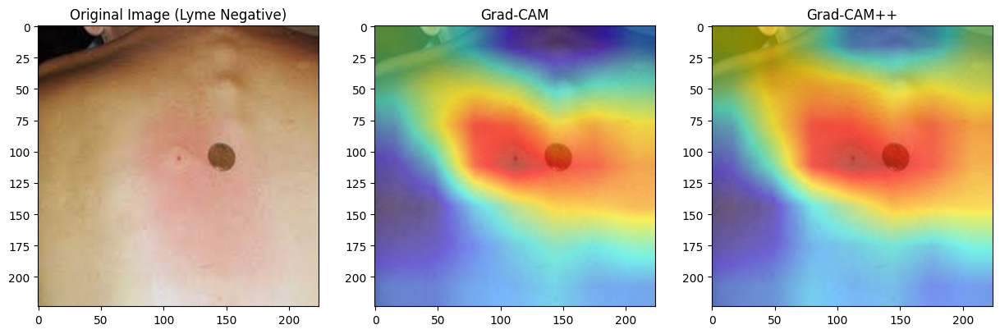

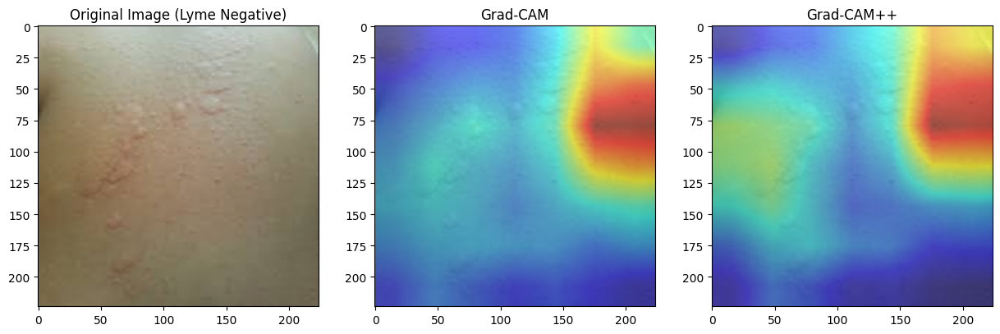

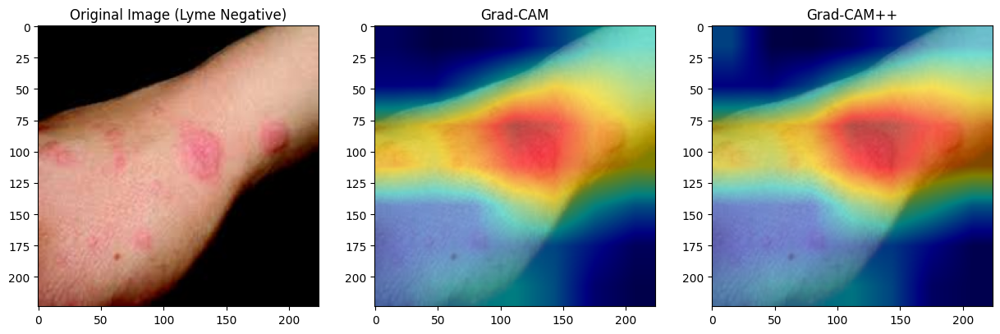

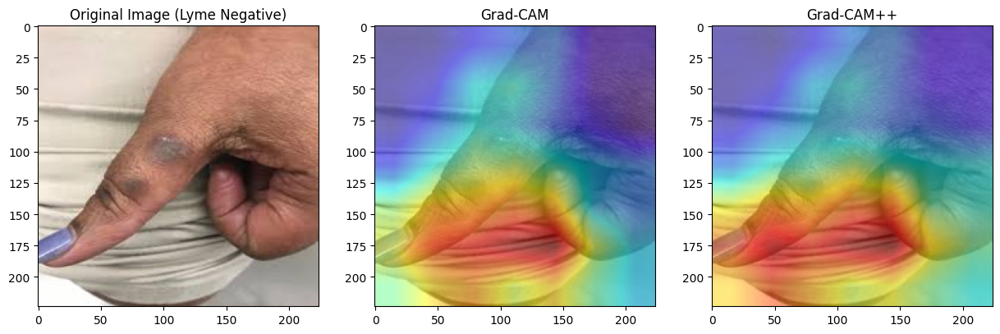

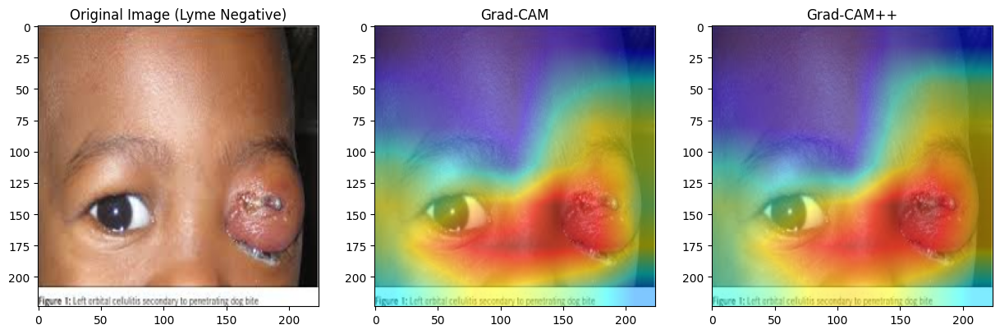

...

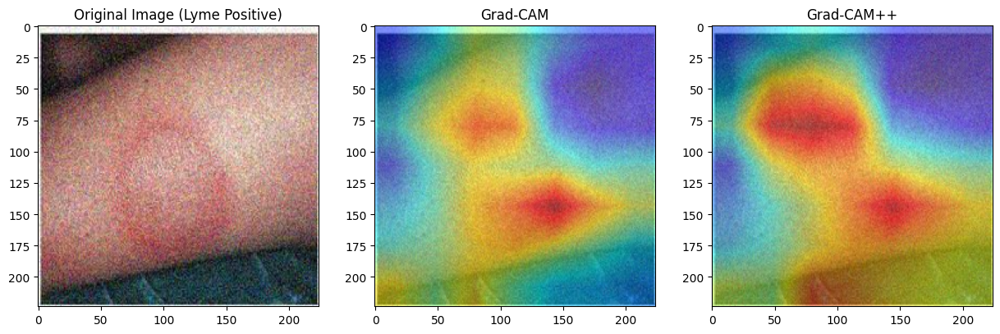

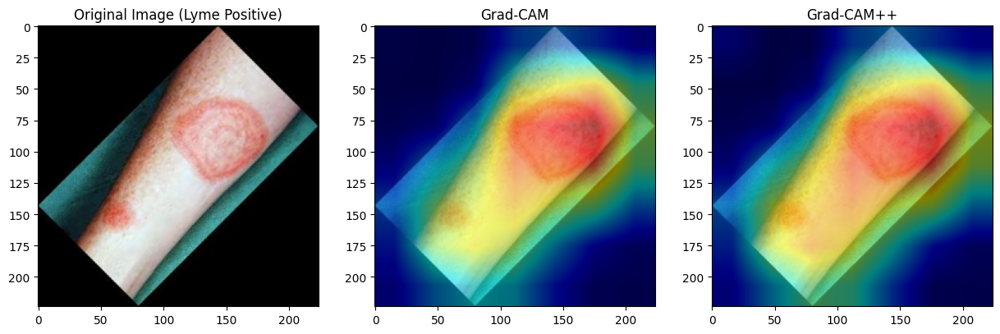

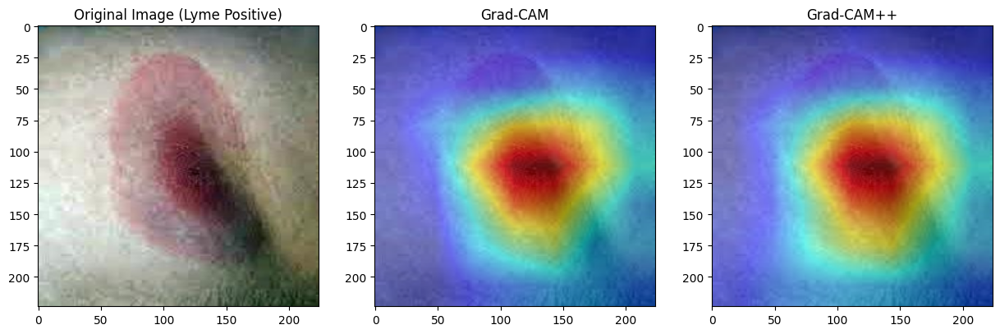

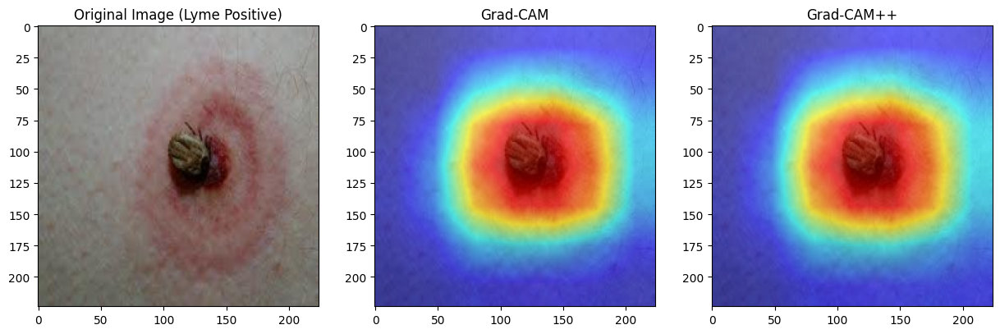

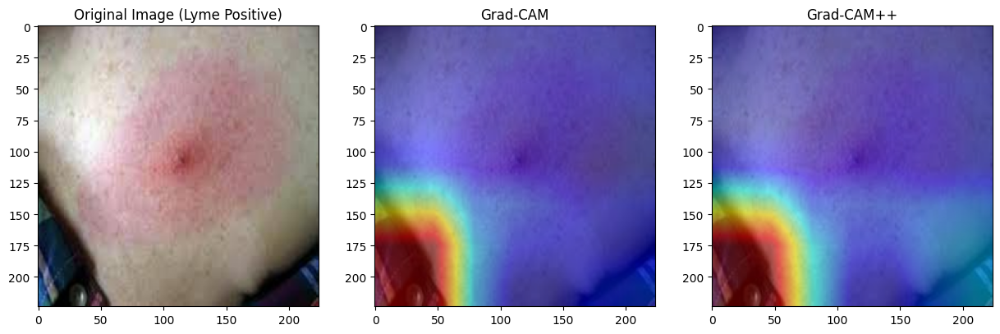

Original image, Grad-CAM, and Grad-CAM++ visualizations with labels in title have been saved in /content/drive/MyDrive/Research Paper/Lyme Disease/GradCAM_Results.


In [ ]:
import os
import random
from PIL import Image
import torch
import torchvision
import torchvision.transforms as transforms
from pytorch_grad_cam import GradCAM, GradCAMPlusPlus
from pytorch_grad_cam.utils.image import show_cam_on_image
import matplotlib.pyplot as plt
import numpy as np

# Directories containing the images
negative_folder = '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/negative'
positive_folder = '/content/drive/MyDrive/Research Paper/Lyme Disease/Final_data/positive'
output_folder = '/content/drive/MyDrive/Research Paper/Lyme Disease/GradCAM_Results'  # Folder to save GradCAM results

# Create output directory if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Load your pre-trained model (ResNet50 used here as an example)
model = torchvision.models.resnet50(pretrained=True)
model.eval()

# Select the target layer for Grad-CAM (usually the last conv layer)
target_layer = model.layer4[-1]

# Transformation for the input image
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Function to generate and save Grad-CAM visualizations
def process_image(image_path, label_text, target_category=0):
    input_image = Image.open(image_path)
    input_tensor = transform(input_image).unsqueeze(0)  # Add batch dimension

    # Use GradCAM and GradCAM++
    cam = GradCAM(model=model, target_layers=[target_layer])
    cam_plus_plus = GradCAMPlusPlus(model=model, target_layers=[target_layer])

    # Generate Grad-CAM and Grad-CAM++ visualizations
    grayscale_cam = cam(input_tensor=input_tensor)[0]  # No target category specified
    grayscale_cam_plus_plus = cam_plus_plus(input_tensor=input_tensor)[0]

    # Convert image back to numpy for overlay
    img = np.array(input_image.resize((224, 224))) / 255.0

    # Superimpose Grad-CAM on the original image
    visualization = show_cam_on_image(img, grayscale_cam, use_rgb=True)
    visualization_plus_plus = show_cam_on_image(img, grayscale_cam_plus_plus, use_rgb=True)

    # Save the results
    base_name = os.path.basename(image_path).split('.')[0]
    output_path_grad_cam = os.path.join(output_folder, f"{base_name}_grad_cam.png")
    output_path_grad_cam_plus_plus = os.path.join(output_folder, f"{base_name}_grad_cam_plus_plus.png")

    # Save images
    plt.imsave(output_path_grad_cam, visualization)
    plt.imsave(output_path_grad_cam_plus_plus, visualization_plus_plus)

    # Display original and Grad-CAM visualizations in the terminal
    plt.figure(figsize=(15, 5))

    # Display the original image with label in title
    plt.subplot(1, 3, 1)
    plt.imshow(img)
    plt.title(f'Original Image ({label_text})')

    # Display Grad-CAM visualization
    plt.subplot(1, 3, 2)
    plt.imshow(visualization)
    plt.title('Grad-CAM')

    # Display Grad-CAM++ visualization
    plt.subplot(1, 3, 3)
    plt.imshow(visualization_plus_plus)
    plt.title('Grad-CAM++')

    # Show the images
    plt.show()

# Function to randomly select and process images from both folders
def select_and_process_images(folder1, folder2, num_images):
    # Get image file paths from both folders
    images_folder1 = [os.path.join(folder1, f) for f in os.listdir(folder1) if f.endswith(('png', 'jpg', 'jpeg'))]
    images_folder2 = [os.path.join(folder2, f) for f in os.listdir(folder2) if f.endswith(('png', 'jpg', 'jpeg'))]

    # Randomly select the specified number of images from each folder
    selected_images_folder1 = random.sample(images_folder1, num_images)
    selected_images_folder2 = random.sample(images_folder2, num_images)

    # Process selected images with appropriate labels
    for image_path in selected_images_folder1:
        process_image(image_path, "Lyme Negative")

    for image_path in selected_images_folder2:
        process_image(image_path, "Lyme Positive")

# Select and process 15 random images from both negative and positive folders
select_and_process_images(negative_folder, positive_folder, 20)

print(f"Original image, Grad-CAM, and Grad-CAM++ visualizations with labels in title have been saved in {output_folder}.")

## LIME

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=02390884d1f8cdfe88a188b967e81d89c3047dd52de19d88075b872ad313215f
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet201_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet201_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /root/.cache/torch/hub/checkpoints/densenet201-c1103571.pth
100%|██████████| 77.4M/77.4M [00:00<00:00, 144MB/s]


  0%|          | 0/1000 [00:00<?, ?it/s]

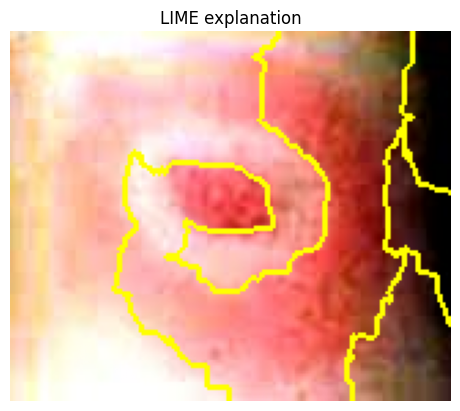

  0%|          | 0/1000 [00:00<?, ?it/s]

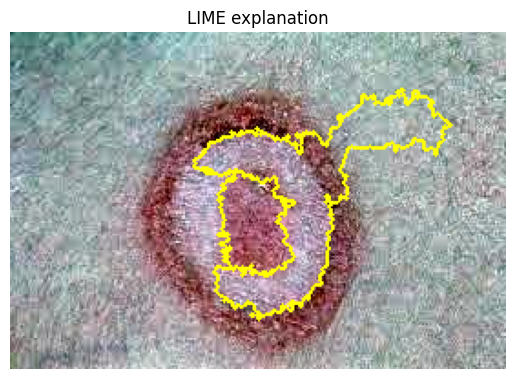

  0%|          | 0/1000 [00:00<?, ?it/s]

In [ ]:
import os
import numpy as np
import torch
from torchvision import models, transforms
from PIL import Image
import matplotlib.pyplot as plt
from lime import lime_image
from skimage.segmentation import mark_boundaries

# Step 1: Load and preprocess the image
data_folder = '/content/drive/MyDrive/Research Paper/Lyme Disease/DATAFORXAI/positive'
image_paths = [os.path.join(data_folder, img) for img in os.listdir(data_folder) if img.endswith('.png') or img.endswith('.jpg')]

# Preprocessing: Image transformations (resize, normalize)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Step 2: Load a pre-trained model (for demonstration, ResNet is used)
model = models.densenet201(pretrained=True)
model.eval()

# Step 3: Function to convert image to numpy array
def preprocess_image(img_path):
    image = Image.open(img_path).convert('RGB')  # Ensure RGB
    image = transform(image)
    return image.unsqueeze(0)

# Step 4: Define a prediction function for LIME
def predict_fn(images):
    # Convert list of images to tensor batch
    batch = torch.stack([transform(Image.fromarray(img).convert('RGB')) for img in images], dim=0)
    # Send to model and get predictions
    with torch.no_grad():
        output = model(batch)
    return output.numpy()

# Step 5: Use LIME to generate explanations
explainer = lime_image.LimeImageExplainer()

for img_path in image_paths:
    img = np.array(Image.open(img_path).convert('RGB'))  # Ensure the image is RGB

    # Check if the image has valid dimensions
    if img.shape[-1] != 3:
        print(f"Skipping image {img_path} due to invalid shape.")
        continue

    # LIME explanation
    explanation = explainer.explain_instance(img, predict_fn, top_labels=1, hide_color=0, num_samples=1000)

    # Get image segmentation and boundaries (only line without painting the image)
    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        hide_rest=True,  # Hide the rest of the image to keep it clean
        num_features=5,
        min_weight=0.01
    )

    # Use mark_boundaries to draw only the boundary lines
    boundary_image = mark_boundaries(img / 255.0, mask, color=(1, 1, 0), mode='thick')  # Use yellow for lines

    # Display the result with only boundary lines
    plt.imshow(boundary_image)
    plt.title(f"LIME explanation")
    plt.axis('off')  # Remove axes for a cleaner image
    plt.show()

## LIME with hybrid model

In [ ]:
!pip install tf-keras-vis

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.5/52.5 kB 1.9 MB/s eta 0:00:00


In [ ]:
import os
import numpy as np
import random
import tensorflow as tf
from tensorflow import keras
from PIL import Image
import matplotlib.pyplot as plt
from lime import lime_image
from skimage.segmentation import mark_boundaries
from tf_keras_vis.gradcam import Gradcam, GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
from tf_keras_vis.scorecam import ScoreCAM
from tf_keras_vis.saliency import Saliency
import cv2

# Directory containing the main folder
base_folder = '/content/drive/MyDrive/Research Paper/Lyme Disease/DATAFORXAI/positive'
output_folder = '/content/drive/MyDrive/Research Paper/Lyme Disease/LIMEXAIFINAL'  # Folder to save XAI results

# Create the output directory if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Preprocessing function
def preprocess_image(img_path):
    img = Image.open(img_path).convert('RGB').resize((224, 224))
    img = np.array(img) / 255.0  # Normalize to [0, 1]
    img = (img - [0.485, 0.456, 0.406]) / [0.229, 0.224, 0.225]  # Apply mean and std normalization (ImageNet)
    return np.expand_dims(img, axis=0)  # Add batch dimension

# Load your Keras model
model_path = '/content/drive/MyDrive/Research Paper/Lyme Disease/AllOutput/Model/Skin-VisualNet.h5'
model = keras.models.load_model(model_path)

# Prediction function for LIME and Grad-CAM
def predict_fn(images):
    # Convert numpy arrays to PIL Images
    images = [Image.fromarray(img.astype('uint8')) for img in images]  # Convert to PIL Image

    batch = np.stack([np.array(img.resize((224, 224))) / 255.0 for img in images], axis=0)
    batch = (batch - [0.485, 0.456, 0.406]) / [0.229, 0.224, 0.225]  # Apply mean and std normalization (ImageNet)
    # Removed the extra dimension
    # batch = np.expand_dims(batch, axis=0)  # Add batch dimension

    predictions = model.predict(batch)
    return predictions

# LIME explainer
explainer = lime_image.LimeImageExplainer()

# Grad-CAM and Grad-CAM++ setup
gradcam = Gradcam(model, model_modifier=ReplaceToLinear(), clone=True)
gradcam_plus_plus = GradcamPlusPlus(model, model_modifier=ReplaceToLinear(), clone=True)

# Score-CAM setup
score_cam = ScoreCAM(model, model_modifier=ReplaceToLinear(), clone=True)

# Vanilla Saliency setup
saliency = Saliency(model, model_modifier=ReplaceToLinear(), clone=True)

# Smooth Grad setup
smooth_grad = Saliency(model, model_modifier=ReplaceToLinear(), clone=True)

# Function to apply colormap on images (used in Grad-CAM and Score-CAM)
def apply_colormap_on_image(org_img, activation, colormap_name='jet'):
    heatmap = np.uint8(255 * activation)
    colormap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    colormap = cv2.cvtColor(colormap, cv2.COLOR_BGR2RGB)
    overlayed_image = 0.5 * org_img + 0.5 * colormap / 255.0
    overlayed_image = np.clip(overlayed_image, 0, 1)
    return overlayed_image

# Function to process 10 random images from each subfolder
def process_images_with_all_techniques(base_folder):
    subfolders = [f.path for f in os.scandir(base_folder) if f.is_dir()]

    for subfolder in subfolders:
        # Get a random sample of 10 images from each subfolder
        images = [os.path.join(subfolder, f) for f in os.listdir(subfolder) if f.lower().endswith(('png', 'jpg', 'jpeg'))]

        # Check if there are enough images for a sample of 10
        num_images = len(images)
        sample_size = min(num_images, 5) # Take a sample of size 10 or the number of images if fewer

        selected_images = random.sample(images, sample_size) # Update this line

        for image_path in selected_images:
            img = preprocess_image(image_path)
            original_img = np.squeeze(img)  # Remove batch dimension

            # Normalize for visualization
            original_img = (original_img * [0.229, 0.224, 0.225]) + [0.485, 0.456, 0.406]  # De-normalize
            original_img = np.clip(original_img, 0, 1)

            # LIME explanation
            explanation = explainer.explain_instance(np.squeeze(img), predict_fn, top_labels=5, hide_color=0, num_samples=2000)
            temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, hide_rest=False, num_features=10, min_weight=0.02)
            boundary_image = mark_boundaries(original_img, mask, color=(1, 1, 0), mode='thick')

            # Grad-CAM and Grad-CAM++ visualizations
            class_index = np.argmax(model.predict(img)[0])
            score = CategoricalScore(class_index)
            cam = gradcam(score, img, penultimate_layer=-1)
            cam_plus_plus = gradcam_plus_plus(score, img, penultimate_layer=-1)
            overlay_cam = apply_colormap_on_image(original_img, cam[0])
            overlay_cam_plus_plus = apply_colormap_on_image(original_img, cam_plus_plus[0])

            # Score-CAM visualization
            cam_score = score_cam(score, img, penultimate_layer=-1)
            overlay_score_cam = apply_colormap_on_image(original_img, cam_score[0])

            # Vanilla Saliency visualization
            vanilla_saliency = saliency(score, img)
            overlay_vanilla_saliency = apply_colormap_on_image(original_img, vanilla_saliency[0])

            # Smooth Grad visualization
            smooth_grad_image = smooth_grad(score, img, smooth_samples=20, smooth_noise=0.20)
            overlay_smooth_grad = apply_colormap_on_image(original_img, smooth_grad_image[0])

            # Show images in output
            plt.figure(figsize=(20, 12))

            # Original image
            plt.subplot(3, 4, 1)
            plt.imshow(original_img)
            plt.title('Original Image')
            plt.axis('off')

            # LIME explanation
            plt.subplot(3, 4, 2)
            plt.imshow(boundary_image)
            plt.title('LIME Explanation')
            plt.axis('off')

            # Grad-CAM
            plt.subplot(3, 4, 3)
            plt.imshow(overlay_cam)
            plt.title('Grad-CAM')
            plt.axis('off')

            # Grad-CAM++
            plt.subplot(3, 4, 4)
            plt.imshow(overlay_cam_plus_plus)
            plt.title('Grad-CAM++')
            plt.axis('off')

            # Score-CAM
            plt.subplot(3, 4, 5)
            plt.imshow(overlay_score_cam)
            plt.title('Score-CAM')
            plt.axis('off')

            # Vanilla Saliency
            plt.subplot(3, 4, 6)
            plt.imshow(overlay_vanilla_saliency)
            plt.title('Vanilla Saliency')
            plt.axis('off')

            # Smooth Grad
            plt.subplot(3, 4, 7)
            plt.imshow(overlay_smooth_grad)
            plt.title('Smooth Grad')
            plt.axis('off')

            plt.tight_layout()
            plt.show()

            # Save images
            output_filename_lime = f"{os.path.basename(image_path).split('.')[0]}_lime.png"
            output_path_lime = os.path.join(output_folder, output_filename_lime)
            plt.imsave(output_path_lime, boundary_image)

            output_filename_gradcam = f"{os.path.basename(image_path).split('.')[0]}_grad_cam.png"
            output_path_gradcam = os.path.join(output_folder, output_filename_gradcam)
            plt.imsave(output_path_gradcam, overlay_cam)

            output_filename_gradcam_pp = f"{os.path.basename(image_path).split('.')[0]}_grad_cam_pp.png"
            output_path_gradcam_pp = os.path.join(output_folder, output_filename_gradcam_pp)
            plt.imsave(output_path_gradcam_pp, overlay_cam_plus_plus)

            output_filename_scorecam = f"{os.path.basename(image_path).split('.')[0]}_score_cam.png"
            output_path_scorecam = os.path.join(output_folder, output_filename_scorecam)
            plt.imsave(output_path_scorecam, overlay_score_cam)

            output_filename_saliency = f"{os.path.basename(image_path).split('.')[0]}_saliency.png"
            output_path_saliency = os.path.join(output_folder, output_filename_saliency)
            plt.imsave(output_path_saliency, overlay_vanilla_saliency)

            output_filename_smooth_grad = f"{os.path.basename(image_path).split('.')[0]}_smooth_grad.png"
            output_path_smooth_grad = os.path.join(output_folder, output_filename_smooth_grad)
            plt.imsave(output_path_smooth_grad, overlay_smooth_grad)

            print(f"Processed and saved results for {os.path.basename(image_path)}.")

# Apply the function for all subfolders under the base folder
process_images_with_all_techniques(base_folder)

print(f"XAI explanations have been saved in {output_folder}.")


TypeError: Error when deserializing class 'InputLayer' using config={'batch_shape': [None, 224, 224, 3], 'dtype': 'float32', 'sparse': False, 'name': 'input_layer'}.

Exception encountered: Unrecognized keyword arguments: ['batch_shape']

## Complexity

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import load_model
import numpy as np
import time
from tensorflow.keras import backend as K

def calculate_model_complexity(model_path):
    # Load the saved model
    model = load_model(model_path)

    # Calculate number of parameters
    total_params = model.count_params()
    trainable_params = sum(tf.size(p).numpy() for p in model.trainable_weights)
    non_trainable_params = sum(tf.size(p).numpy() for p in model.non_trainable_weights)

    # Calculate FLOPS using tf.compat.v1 if TF 2.x is used
    def get_flops(model):
        # Use tf.compat.v1 if TF 2.x is used
        if tf.__version__.startswith('2'):
            # This part assumes you're using TensorFlow 2.x
            # The tf.compat.v1 functions have similar functionality
            with tf.compat.v1.Session() as sess:
                sess.run(tf.compat.v1.global_variables_initializer())
                run_meta = tf.compat.v1.RunMetadata()
                opts = tf.compat.v1.profiler.ProfileOptionBuilder.float_operation()
                # Remove 'graph=K.get_session().graph'
                flops = tf.compat.v1.profiler.profile(run_meta=run_meta,
                                                        cmd='op',
                                                        options=opts)
                return flops.total_float_ops  # Accessing total_float_ops
        else:
            # Original code if using TF 1.x
            run_meta = tf.RunMetadata()
            opts = tf.profiler.ProfileOptionBuilder.float_operation()
            # Remove 'graph=K.get_session().graph'
            flops = tf.profiler.profile(run_meta=run_meta,
                                           cmd='op',
                                           options=opts)
            return flops.total_float_ops
    flops = get_flops(model)

    # Measure inference time
    input_shape = model.input_shape[1:]
    dummy_input = np.random.rand(1, *input_shape)

    # Warm up
    for _ in range(10):
        model.predict(dummy_input)

    # Measure time
    start_time = time.time()
    num_iterations = 100
    for _ in range(num_iterations):
        model.predict(dummy_input)
    end_time = time.time()

    inference_time = (end_time - start_time) / num_iterations

    return {
        'total_parameters': total_params,
        'trainable_parameters': trainable_params,
        'non_trainable_parameters': non_trainable_params,
        'flops': flops,
        'inference_time_ms': inference_time * 1000
    }

def print_complexity_metrics(metrics):
    print("\nModel Complexity Metrics:")
    print(f"Total Parameters: {metrics['total_parameters']:,}")
    print(f"Trainable Parameters: {metrics['trainable_parameters']:,}")
    print(f"Non-trainable Parameters: {metrics['non_trainable_parameters']:,}")
    print(f"Floating Point Operations (FLOPS): {metrics['flops']:,}")
    print(f"Average Inference Time: {metrics['inference_time_ms']:.2f} ms")

# Usage
model_path = "/content/drive/MyDrive/Lyme Disease/AllOutput/Model/Skin-VisualNet.h5"  # Replace with your model path
metrics = calculate_model_complexity(model_path)
print_complexity_metrics(metrics)

1/1 ━━━━━━━━━━━━━━━━━━━━ 41s 41s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, GlobalAveragePooling2D, Concatenate, BatchNormalization, Activation, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.applications import DenseNet201, VGG19, ResNet50V2
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2
import numpy as np
import time

# Define the input shape
input_shape = (224, 224, 3)

# Enable mixed precision
policy = tf.keras.mixed_precision.Policy('mixed_float16')
tf.keras.mixed_precision.set_global_policy(policy)

def create_hybrid_model(model1_fn, model2_fn):
    """
    Create a hybrid model using separate instances of pre-trained models
    """
    # Create input layer
    inputs = Input(shape=input_shape)

    # Create the first model instance
    model1 = model1_fn(include_top=False, input_tensor=inputs, weights='imagenet')

    # Create the second model instance
    model2 = model2_fn(include_top=False, input_tensor=inputs, weights='imagenet')

    # Global average pooling for each model
    model1_gap = GlobalAveragePooling2D(name=f'{model1_fn.__name__.lower()}_gap')(model1.output)
    model2_gap = GlobalAveragePooling2D(name=f'{model2_fn.__name__.lower()}_gap')(model2.output)

    # Concatenate features
    concat = Concatenate(name='concat_features')([model1_gap, model2_gap])

    # Add batch normalization
    bn1 = BatchNormalization(name='bn1')(concat)

    # Dense layers
    dense1 = Dense(512, kernel_regularizer=l2(0.001), name='dense1')(bn1)
    bn2 = BatchNormalization(name='bn2')(dense1)
    act1 = Activation('relu', name='relu1')(bn2)
    drop1 = Dropout(0.5, name='dropout1')(act1)

    dense2 = Dense(256, kernel_regularizer=l2(0.001), name='dense2')(drop1)
    bn3 = BatchNormalization(name='bn3')(dense2)
    act2 = Activation('relu', name='relu2')(bn3)
    drop2 = Dropout(0.5, name='dropout2')(act2)

    # Output layer
    outputs = Dense(2, activation='softmax', dtype='float32', name='output')(drop2)

    # Create model
    model = Model(inputs=inputs, outputs=outputs)

    # Compile model
    optimizer = Adam(learning_rate=0.00001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    return model

def estimate_complexity(model):
    """
    Estimate model complexity metrics
    """
    # Calculate parameters
    total_params = model.count_params()
    trainable_params = sum([tf.keras.backend.count_params(w) for w in model.trainable_weights])
    non_trainable_params = total_params - trainable_params

    # Estimate FLOPs (this is a rough estimate)
    # For a more accurate measure, you would need a specialized tool
    # This approximation is based on the number of multiply-adds in the model
    input_shape_prod = np.prod(input_shape)
    flops_estimate = total_params * input_shape_prod * 2  # Rough approximation

    # Measure inference time
    # Create dummy input
    dummy_input = np.ones((1, *input_shape))

    # Warm-up runs
    for _ in range(5):
        _ = model.predict(dummy_input)

    # Timed runs
    iterations = 20
    start_time = time.time()
    for _ in range(iterations):
        _ = model.predict(dummy_input)
    end_time = time.time()

    avg_inference_time = (end_time - start_time) / iterations

    return {
        'total_parameters': total_params,
        'trainable_parameters': trainable_params,
        'non_trainable_parameters': non_trainable_params,
        'estimated_flops': flops_estimate,
        'avg_inference_time_ms': avg_inference_time * 1000
    }

# Define model pairs to evaluate
model_pairs = [
    (VGG19, DenseNet201),
    (VGG19, ResNet50V2)
]

# Evaluate each model pair
for model1_fn, model2_fn in model_pairs:
    print(f"\n{'='*50}")
    print(f"Evaluating Hybrid Model: {model1_fn.__name__} + {model2_fn.__name__}")
    print(f"{'='*50}")

    # Create the hybrid model
    hybrid_model = create_hybrid_model(model1_fn, model2_fn)

    # Calculate complexity metrics
    complexity = estimate_complexity(hybrid_model)

    # Display results
    print(f"\nModel Complexity Metrics:")
    print(f"Total Parameters: {complexity['total_parameters']:,}")
    print(f"Trainable Parameters: {complexity['trainable_parameters']:,}")
    print(f"Non-trainable Parameters: {complexity['non_trainable_parameters']:,}")
    print(f"Estimated FLOPs: {complexity['estimated_flops']:,}")
    print(f"Average Inference Time: {complexity['avg_inference_time_ms']:.2f} ms")





Evaluating Hybrid Model: VGG19 + DenseNet201
1/1 ━━━━━━━━━━━━━━━━━━━━ 26s 26s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step

Mod

## Figure

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Confusion matrix values
cm = np.array([[846, 12],
               [7, 760]])

# Generate predicted and true labels from confusion matrix
y_true = [0]*858 + [1]*767  # 730+91=821 actual 0s, 34+770=804 actual 1s
y_pred = [0]*846 + [1]*12 + [0]*7 + [1]*760

# Calculate metrics
precision = precision_score(y_true, y_pred) * 100
recall = recall_score(y_true, y_pred) * 100
f1 = f1_score(y_true, y_pred) * 100
accuracy = accuracy_score(y_true, y_pred) * 100

# Print results
print(f'Accuracy: {accuracy:.2f}%')
print(f'Precision: {precision:.2f}%')
print(f'Recall: {recall:.2f}%')
print(f'F1-Score: {f1:.2f}%')

# Plot confusion matrix at 1200 DPI
plt.figure(figsize=(8, 6), dpi=1200)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True)
plt.title('SkinVisualNet Confusion Matrix', fontsize=14)
plt.xlabel('Predicted', fontsize=12)
plt.ylabel('True', fontsize=12)

# Save high-res plot
output_path = '/content/drive/MyDrive/Lyme Disease/ALL figure/skinvisualnet_confusion_matrix_1200dpi.png'
plt.savefig(output_path, bbox_inches='tight', dpi=1200)
plt.show()


Accuracy: 98.83%
Precision: 98.45%
Recall: 99.09%
F1-Score: 98.77%


In [ ]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Updated model results
results = {
    'VGG19': {'Precision': 89.43, 'Recall': 95.77, 'F1 Score': 92.49, 'Accuracy': 92.31},
    'DenseNet201': {'Precision': 93.34, 'Recall': 92.98, 'F1 Score': 93.16, 'Accuracy': 93.54},
    'ResNet50V2': {'Precision': 94.92, 'Recall': 95.27, 'F1 Score': 95.10, 'Accuracy': 95.14},
    'Skin VisualNet': {'Precision': 98.45, 'Recall': 99.09, 'F1 Score': 98.77, 'Accuracy': 98.83}
}

# Model to color mapping
model_colors = {
    'VGG19': '#B4D8DE',
    'DenseNet201': '#8CB368',
    'ResNet50V2': '#36454f',
    'Skin VisualNet': '#211d38'
}

# Convert results to DataFrame
df_results = pd.DataFrame(results).T  # Transpose to get models as rows
df_results.reset_index(inplace=True)
df_results.rename(columns={'index': 'Model'}, inplace=True)

# Melt the DataFrame for seaborn plotting
df_melted = df_results.melt(id_vars="Model", var_name="Metric", value_name="Score")

# Set seaborn aesthetics
sns.set(style="whitegrid", font_scale=1.2)

# Create high-resolution figure (1200 DPI)
plt.figure(figsize=(14, 8), dpi=1200)

# Create a custom color palette
palette_dict = model_colors
palette = [palette_dict[model] for model in df_melted['Model'].unique()]

# Create the bar plot
p = sns.barplot(x='Metric', y='Score', hue='Model', data=df_melted, palette=palette)

# Add score labels to bars
for container in p.containers:
    p.bar_label(container, fmt='%.2f', label_type='edge', padding=3, fontsize=9, color='black')

# Enhance plot with titles and labels
plt.title('Comparison of Model Metrics', fontsize=16)
plt.xlabel('Metric', fontsize=14)
plt.ylabel('Score (%)', fontsize=14)

# Legend placement
plt.legend(title='Model', loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True, shadow=True, ncol=4)

plt.tight_layout(rect=[0, 0, 1, 0.95])

# Save the plot (update path as needed)
output_dir = '/content/drive/MyDrive/Lyme Disease/ALL figure'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
output_path = os.path.join(output_dir, 'updated_metrics_plot_1200dpi.png')
plt.savefig(output_path, bbox_inches='tight', dpi=1200)

plt.show()

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
output_path = '/content/drive/MyDrive/Lyme Disease/ALL figure/before pre'
def calculate_metrics(confusion_matrix):
    """
    Calculate precision, recall, F1-score, and accuracy from a confusion matrix.
    """
    tn, fp = confusion_matrix[0, 0], confusion_matrix[0, 1]
    fn, tp = confusion_matrix[1, 0], confusion_matrix[1, 1]

    # Calculate metrics
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    accuracy = (tp + tn) / (tp + tn + fp + fn)

    return {
        'precision': precision * 100,
        'recall': recall * 100,
        'f1': f1 * 100,
        'accuracy': accuracy * 100
    }

def plot_confusion_matrix(confusion_matrix, model_name, output_path):
    """
    Generate and save a high-resolution confusion matrix plot.
    """
    plt.figure(figsize=(8, 6), dpi=1200)
    sns.heatmap(confusion_matrix, annot=True, fmt='d', cmap='Blues', cbar=True)
    plt.title(f'{model_name} Confusion Matrix', fontsize=14)
    plt.xlabel('Predicted', fontsize=12)
    plt.ylabel('True', fontsize=12)

    # Save high-resolution plot
    plt.savefig(output_path, bbox_inches='tight', dpi=1200)
    plt.close()  # Close the figure to free memory

# Example usage with the provided matrices
matrices = {
    'ResNet50V2': np.array([[785, 58],
                           [36, 93]]),
    'DenseNet201': np.array([[785, 58],
                            [44, 85]]),
    'SkinVisualNet': np.array([[781, 36],
                              [50, 105]]),
    'VGG19': np.array([[839, 4],
                      [6, 123]])
}

# Process each model's results
for model_name, matrix in matrices.items():
    # Calculate metrics
    metrics = calculate_metrics(matrix)

    # Print metrics
    print(f"\n{model_name} Metrics:")
    print(f"Accuracy: {metrics['accuracy']:.2f}%")
    print(f"Precision: {metrics['precision']:.2f}%")
    print(f"Recall: {metrics['recall']:.2f}%")
    print(f"F1-Score: {metrics['f1']:.2f}%")

    # Generate and save plot
    output_path = f'{model_name}_confusion_matrix_1200dpi.png'
    plot_confusion_matrix(matrix, model_name, output_path)


ResNet50V2 Metrics:
Accuracy: 90.33%
Precision: 61.59%
Recall: 72.09%
F1-Score: 66.43%

DenseNet201 Metrics:
Accuracy: 89.51%
Precision: 59.44%
Recall: 65.89%
F1-Score: 62.50%

SkinVisualNet Metrics:
Accuracy: 91.15%
Precision: 74.47%
Recall: 67.74%
F1-Score: 70.95%

VGG19 Metrics:
Accuracy: 98.97%
Precision: 96.85%
Recall: 95.35%
F1-Score: 96.09%


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Define the save path
save_path = "/content/drive/MyDrive/Lyme Disease/ALL figure/before pre"
# Create the directory if it doesn't exist
os.makedirs(save_path, exist_ok=True)

# Define the confusion matrices from the images
confusion_matrices = {
    "VGG19": np.array([[839, 4], [123, 6]]),
    "ResNet50V2": np.array([[785, 58], [93, 36]]),
    "DenseNet201": np.array([[785, 58], [85, 44]]),
    "SkinVisualNet": np.array([[781, 36], [105, 50]])
}

# Function to calculate metrics from a confusion matrix
def calculate_metrics(conf_matrix):
    TN, FP = conf_matrix[0, 0], conf_matrix[0, 1]
    FN, TP = conf_matrix[1, 0], conf_matrix[1, 1]

    # Total samples
    total = TN + FP + FN + TP

    # Accuracy: (TP + TN) / total
    accuracy = (TP + TN) / total * 100

    # Precision: TP / (TP + FP)
    precision = TP / (TP + FP) * 100 if (TP + FP) != 0 else 0

    # Recall: TP / (TP + FN)
    recall = TP / (TP + FN) * 100 if (TP + FN) != 0 else 0

    # F1-Score: 2 * (Precision * Recall) / (Precision + Recall)
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) != 0 else 0

    return {
        "accuracy": accuracy,
        "precision": precision,
        "recall": recall,
        "f1": f1
    }

# Function to plot and save confusion matrix at 1200 DPI
def plot_confusion_matrix(conf_matrix, model_name, save_path):
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=True,
                xticklabels=["0", "1"], yticklabels=["0", "1"])
    plt.title(f"{model_name} Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()

    # Save the plot at 1200 DPI in the specified path
    save_file = os.path.join(save_path, f"{model_name}_confusion_matrix.png")
    plt.savefig(save_file, dpi=1200)
    plt.close()

# Loop through each model, calculate metrics, and plot confusion matrix
for model_name, conf_matrix in confusion_matrices.items():
    # Calculate metrics
    metrics = calculate_metrics(conf_matrix)

    # Print metrics
    print(f"\n{model_name} Metrics:")
    print(f"Accuracy: {metrics['accuracy']:.2f}%")
    print(f"Precision: {metrics['precision']:.2f}%")
    print(f"Recall: {metrics['recall']:.2f}%")
    print(f"F1-Score: {metrics['f1']:.2f}%")

    # Plot and save confusion matrix
    plot_confusion_matrix(conf_matrix, model_name, save_path)

print(f"\nConfusion matrices have been saved as PNG files at 1200 DPI in {save_path}.")


VGG19 Metrics:
Accuracy: 86.93%
Precision: 60.00%
Recall: 4.65%
F1-Score: 8.63%

ResNet50V2 Metrics:
Accuracy: 84.47%
Precision: 38.30%
Recall: 27.91%
F1-Score: 32.29%

DenseNet201 Metrics:
Accuracy: 85.29%
Precision: 43.14%
Recall: 34.11%
F1-Score: 38.10%

SkinVisualNet Metrics:
Accuracy: 85.49%
Precision: 58.14%
Recall: 32.26%
F1-Score: 41.49%

Confusion matrices have been saved as PNG files at 1200 DPI in /content/drive/MyDrive/Lyme Disease/ALL figure/before pre.
